## PH: 6 Exploratory Data Analysis

In [1]:
import pandas as pd
import numpy as np
import math
import requests
import seaborn as sns
import matplotlib.pyplot as plt
import json
import urllib.request
import folium
import branca.colormap as cm
from collections import defaultdict
from folium.plugins import HeatMap
import warnings

In [2]:
class ExploreData():
    def __init__(self):
        self.date = '202307'
        
    def import_data(self):
        warnings.filterwarnings('ignore')

        paths = ['/kaggle/input/ph-4-data-engineering',
                '/kaggle/input/ph-4-data-engineering',
                '/kaggle/input/ph-4-data-engineering',
                '/kaggle/input/ph-4-data-engineering',
                '/kaggle/input/ph-4-data-engineering',
                '/kaggle/input/ph-4-data-engineering',
                '/kaggle/input/ph-5-geocoding']
        file_names = [f"{self.date}_project.csv",
                     f"{self.date}_project_name.csv",
                     f"{self.date}_project_unit_type.csv",
                     f"{self.date}_property_nearby.csv",
                     f"{self.date}_room_1.csv",
                     f"{self.date}_room_2.csv",
                     f"{self.date}_project_geo.csv"]
        
        self.project = pd.read_csv(f'{paths[0]}/{file_names[0]}')
        self.project_name = pd.read_csv(f'{paths[1]}/{file_names[1]}')
        self.project_unit_type = pd.read_csv(f'{paths[2]}/{file_names[2]}')
        self.property_nearby = pd.read_csv(f'{paths[3]}/{file_names[3]}')
        room_1 = pd.read_csv(f'{paths[4]}/{file_names[4]}')
        room_2 = pd.read_csv(f'{paths[5]}/{file_names[5]}')
        self.room = pd.concat([room_1,room_2], axis=0)
        self.project_geo = pd.read_csv(f'{paths[6]}/{file_names[6]}')
        print(f'Data imported !')
        
    def find_new_condo_locations(self):
        # check if there are any new condo locations in self.project
        # If there is a new condo location, manually put in coordinates. No need to rerun ph-5-x-geocoding
        self.not_found = []
        lat_temp = []
        lon_temp = []
        gg_address_temp = []
        
        for i in range(len(EDA.project)):
            if sum(self.project_geo['project_name']==self.project['project_name'][i]):
                df_temp = self.project_geo[self.project_geo['project_name']==self.project['project_name'][i]]
                lat_temp.append(df_temp['lat'].values[0])
                lon_temp.append(df_temp['lon'].values[0])
                gg_address_temp.append(df_temp['gg_address'].values[0])
            else:
                self.not_found.append(self.project['project_name'][i])
                lat_temp.append('')
                lon_temp.append('')
                gg_address_temp.append('')
                
        EDA.project['lat'] = lat_temp
        EDA.project['lon'] = lon_temp
        EDA.project['gg_address'] = gg_address_temp
        
        if len(self.not_found):
            print(f'!!! There are {len(self.not_found)} new condo locations')
            [print(e) for e in self.not_found]
        else:
            print(f'There are NO new condo locations !')
            
    def manual_fill_in_geocode(self):
        dict_temp = {'Bangrak Condominium':{'lat':13.714090066142358, 'lon':100.51365968451798, 'gg_address':'5, 6 Charoen Krung 63 Alley, Yan Nawa, Sathon, Bangkok 10120'},
                    'Best Western Premier Bayphere Pattaya':{'lat':12.8414818656144, 'lon':100.90539501780162, 'gg_address':'159 หมู่ที่ 2 Na Chom Thian 18 Alley, Na Chom Thian, Sattahip District, Chon Buri 20250'},
                    'Blue Lagoon Resort Hua Hin':{'lat':12.665681221997142, 'lon':99.95412929682352, 'gg_address':'1991 21 Petchkasem Rd, Cha-am, Cha-am District, Phetchaburi 76120'},
                    'Chiang Mai Riverside Condominium':{'lat':18.76542200643797, 'lon':99.00489704468195, 'gg_address':'11 324 324/11 Chiang Mai-Lam Phun Rd, เมือง Chiang Mai 50000'},
                    'Duliya Chalisma':{'lat':13.759270385312774, 'lon':100.58771050862325, 'gg_address':'531/82 อาคาร 3 พระราม 9 ชอย 13 Rama IX Rd, Bang Kapi, Huai Khwang, Bangkok 10310'},
                    'Duliya Place Condo':{'lat':13.809453720549746, 'lon':100.60378719637775, 'gg_address':'Duriya Place, Lat Phrao, Bangkok 10230'},
                    'Future Place Condominium':{'lat':13.9970378413777611, 'lon':100.61073009518385, 'gg_address':'XJW6+R79, Rangsit-Pathum Thani 8, Prachathipat, Thanyaburi District, Pathum Thani 12130'},
                    'Intercontinental Residences Hua Hin':{'lat':12.55843760852181, 'lon':99.96110128465311, 'gg_address':'HX56+9FF, Hua Hin 71 Alley, Hua Hin, Amphoe Hua Hin, Prachuap Khiri Khan 77110'},
                    'Krungthep Thani Tower':{'lat':13.72567338151181, 'lon':100.56709297756392, 'gg_address':'56 ซอย สุขุมวิท 24 สุขุมวิท Khlong Tan, Khlong Toei, Bangkok 10110'},
                    'Ladda Place Condo Sriracha':{'lat':13.157144119667313, 'lon':100.93145672848962, 'gg_address':'399 Si Racha District, Chon Buri 20110'},
                    'Long Beach Condo':{'lat':12.811219802191273, 'lon':100.91496579649295, 'gg_address':'RW67+GX4, Soi Na Chom Thian 3, Na Chom Thian, Sattahip District, Chon Buri 20250'},
                    'Magnolias Waterfront Residences':{'lat':13.727299244884867, 'lon':100.51049984105484, 'gg_address':'259 Charoen Nakhon Rd, Khlong Ton Sai, Khlong San, Bangkok 10600'},
                    'New Nordic C - View Boutique':{'lat':12.916375001496784, 'lon':100.86237379514665, 'gg_address':'395, 52 Pratamnak Rd, Pattaya City, Bang Lamung District, Chon Buri 20150'},
                    'New York Condo':{'lat':13.828004648731175, 'lon':100.67717604357213, 'gg_address':'RMHG+6V4, Khan Na Yao, Bangkok 10230'},
                    'North Park Place':{'lat':13.873740975825289, 'lon':100.5645313636577, 'gg_address':'วิภาวดี-รังสิต Tha Sai 1 Alley, Thung Song Hong, Lak Si, Bangkok 10210'},
                    'Ocean Sands':{'lat':8.017877764718165, 'lon':98.30540163445919, 'gg_address':'26/1 Khok Tanode, Soi 14, Choeng Thale, Thalang District, Phuket 83110'},
                    'The Pixels Cape Panwa Condo':{'lat':7.80661672757467, 'lon':98.40545303197709, 'gg_address':'RC44+M5Q, Wichit, Mueang Phuket District, Phuket 83000'},
                    'Thepharak 3 Housing Baan Eua Ar Thorn  Thepharak 3':{'lat':13.59499382899461, 'lon':100.7009282510628, 'gg_address':'ส ป ง111/40หมู่20 ถ บางพลี-ตำหรุ ตำบลบางพลีใหญ่ อำเภอบางพลี จังหวัด ตำบล Samut Prakan 10540'},
                    'X2 Vibe Phuket Bangtao':{'lat':7.8998327069403524, 'lon':98.2989857592865, 'gg_address':'5/56 Haad Patong Road, Pa Tong, Kathu District, Phuket 83150'}}
        
        for condo,geo in dict_temp.items():
            self.project.loc[(self.project['project_name'] == condo),'lat'] = geo['lat']
            self.project.loc[(self.project['project_name'] == condo),'lon'] = geo['lon']
            self.project.loc[(self.project['project_name'] == condo),'gg_address'] = geo['gg_address']
        
        print(f'Geocodes manually filled for NaN geocodes !')
        
    def get_provinces_districts(self):
        page_province = 'https://en.wikipedia.org/wiki/Provinces_of_Thailand'
        page_district = 'https://en.wikipedia.org/wiki/List_of_districts_of_Thailand'
        page_district_bkk = 'https://en.wikipedia.org/wiki/List_of_districts_of_Bangkok'
        self.df_province = pd.read_html(requests.get(page_province).content)[2]
        self.df_district = pd.read_html(requests.get(page_district).content)[0]
        self.df_district_bkk = pd.read_html(requests.get(page_district_bkk).content)[0]
        self.df_region = pd.read_html(requests.get(page_district).content)[1]

        self.df_province['Name'] = self.df_province['Namesake town/city']
        self.df_province.drop(['Seal', 'HS[6]', 'ISO[7]', 'FIPS', 'Namesake town/city'], axis=1, inplace=True)
        self.df_province.columns = ['Name', 'Name (in Thai)', 'Population (Dec22)', 'Area (km2)', 'Population Density']
        self.df_district.columns = ['District', 'Amphoe', 'Province', 'Changwat', 'Region']
        self.df_district_bkk.columns = ['District', 'Map No', 'Postal', 'Amphoe', 'Population','No of Khwaengs','lat','lon']
        self.df_district_bkk['Province'] = 'Bangkok'
        self.df_district_bkk['Changwat'] = 'กรุงเทพมหานคร'
        self.df_district_bkk['Region'] = 'Centre'
        self.df_district_bkk.drop(['Map No', 'Postal','Population','No of Khwaengs','lat','lon'], axis=1, inplace=True)
        self.df_district = pd.concat([self.df_district,self.df_district_bkk], axis=0)
        self.df_district.reset_index(drop=True, inplace=True)
        self.df_region.drop('Transcription', axis=1, inplace=True)
        self.df_region.columns = ['Region', 'Region (in Thai)']
        
        print(f'Tables loaded : Thailand provinces and districts from Wiki !')
    
    def get_provinces(self):
        provinces = []
        not_found_index = []
        two_names_index = []   # in case there are 2 province names in the address

        for i in range(len(self.project)):
            prov_flag = 0
            for j in range(len(self.df_province)):
                prov_en = self.df_province['Name'][j]
                prov_th = self.df_province['Name (in Thai)'][j]
                address_temp = self.project['address'][i].replace(prov_th,prov_en)
                address_temp = address_temp.replace('Samut Prakarn','Samut Prakan')
                address_temp = address_temp.replace('Prachaubkirikhan','Prachuap Khiri Khan')
                address_temp = address_temp.replace('Petchburi','Phetchaburi')
                address_temp = address_temp.replace('Pathumthani','Pathum Thani')
                address_temp = address_temp.replace('Phra Nakhon Sri Ayutthaya','Phra Nakhon Si Ayutthaya')
                address_temp = address_temp.replace('Buri Ram','Buriram')
                address_temp = address_temp.replace('MontAzure Lakeside','Phuket')
                if address_temp.find(prov_en) >= 0:
                    prov_flag += 1
                    if prov_flag == 1:
                        provinces.append(prov_en)
                    elif prov_flag == 2:
                        provinces.append('Two Names')
                        two_names_index.append(i)
                    
            if prov_flag==0:
                provinces.append('Not Found')
                not_found_index.append(i)
        
        self.project['province'] = provinces
        print('--'*10)
        print('Getting provinces')
        print(f"No. of two names = {len(two_names_index)}")
        print(f"No. of not founds = {len(not_found_index)}")
    
    def get_districts(self):
        districts = []
        not_found_index = []
        two_names_index = []   # in case there are 2 province names in the address

        for i in range(len(self.project)):
            dist_flag = 0
            for j in range(len(self.df_district)):
                dist_en = self.df_district['District'][j]
                dist_th = self.df_district['Amphoe'][j]
                address_temp = self.project['address'][i].replace(dist_th,dist_en)
                address_temp = address_temp.replace('Muang','Mueang')
                address_temp = address_temp.replace('Samut Prakarn','Samut Prakan')
                address_temp = address_temp.replace('Chon Buri','Chonburi')
                address_temp = address_temp.replace('Cha-Am','Cha-am')
                address_temp = address_temp.replace('Nakhon Chai Sri','Nakhon Chai Si')
                address_temp = address_temp.replace('Bang Plee','Bang Phli')
                address_temp = address_temp.replace('Phuttha Mon Thon','Phutthamonthon')
                address_temp = address_temp.replace('Buri Ram','Buriram')
                address_temp = address_temp.replace('Mae Sod','Mae Sot')
                address_temp = address_temp.replace('Sri Maha Pho','Si Maha Phot')
                address_temp = address_temp.replace('Phra Pra Daeng','Phra Pradaeng')
                address_temp = address_temp.replace('Kensington ระยอง 1 , 2','Mueang Rayong')
                address_temp = address_temp.replace('MontAzure Lakeside','Kathu')

                if address_temp.find(dist_en) >= 0:
                    dist_flag += 1
                    if dist_flag == 1:
                        districts.append(dist_en)
                    elif dist_flag == 2:
                        districts.pop()
                        districts.append('Two Names')
                        two_names_index.append(i)

            if dist_flag==0:
                districts.append('Not Found')
                not_found_index.append(i)

        df_districts = pd.DataFrame({'district':districts})

        for i in two_names_index:
            address_temp = self.project['address'][i]
            if address_temp.find('Lat Phrao') >= 0:
                df_districts.loc[i,'district'] = 'Lat Phrao'
            elif address_temp.find('Wang Thonglang') >= 0:
                df_districts.loc[i,'district'] = 'Wang Thonglang'
            elif address_temp.find('Hat Yai') >= 0:
                df_districts.loc[i,'district'] = 'Hat Yai'
            elif address_temp.find('Chom Thong') >= 0:
                df_districts.loc[i,'district'] = 'Chom Thong'
            elif address_temp.find('Bang Kapi') >= 0:
                df_districts.loc[i,'district'] = 'Bang Kapi'
            elif address_temp.find('Nong Khaem') >= 0:
                df_districts.loc[i,'district'] = 'Nong Khaem'
            elif address_temp.find('Nakhon Chai Sri') >= 0:
                df_districts.loc[i,'district'] = 'Nakhon Chai Si'
            elif address_temp.find('Uthai') >= 0:
                df_districts.loc[i,'district'] = 'Uthai'
            elif address_temp.find('Phan Thong') >= 0:
                df_districts.loc[i,'district'] = 'Phan Thong'
            else:
                df_districts.loc[i,'district'] = 'Two Names'
        
        self.project['district'] = df_districts['district']
        print('--'*10)
        print('Getting districts')
        print(f"No. of two names = {len(df_districts[df_districts['district']=='Two Names'])}")
        print(f"No. of not founds = {len(not_found_index)}")
        print('--'*10)
        
    def remove_outliers(self):
        # Remove outliers based on 1st project_name and then 2nd unit_type
        # For-rent, filter out prices more than 800k
        print('Removing outliers outside IQR ...')
        
        rent_flag = 1
        IQR_factor = 1.5
        self.room_rent_cln = pd.DataFrame({})

        room_rent = self.room[self.room['rent_flag']==rent_flag]
        room_rent.dropna(subset = ['unit_type'], inplace=True)
        room_rent.dropna(subset = ['price'], inplace=True)
        room_rent = room_rent[room_rent['price']<=800000]
        unit_types = room_rent.groupby(by="unit_type")['unit_type'].count().index.values
        
        print(f"For-rent: before removing outliers: {len(room_rent)} records")
        for condo_name in self.project['project_name']:
            room_temp = room_rent[room_rent['project_name']==condo_name]
            if len(room_temp):
                for unit_type in unit_types:
                    room_unit_temp = room_temp[room_temp['unit_type']==unit_type]
                    if len(room_unit_temp):
                        Q1 = room_unit_temp['price'].quantile(0.25)
                        Q3 = room_unit_temp['price'].quantile(0.75)
                        IQR = Q3-Q1
                        upper = Q3+IQR_factor*IQR
                        room_unit_temp = room_unit_temp[(room_unit_temp['price']<=upper)]
                        self.room_rent_cln = pd.concat([self.room_rent_cln,room_unit_temp],axis=0)
        self.room_rent_cln.reset_index(inplace=True, drop=True)
        print(f"For-rent: after removing outliers: {len(self.room_rent_cln)} records")
        
        rent_flag = 0
        self.room_sale_cln = pd.DataFrame({})

        room_sale = self.room[self.room['rent_flag']==rent_flag]
        room_sale.dropna(subset = ['unit_type'], inplace=True)
        room_sale.dropna(subset = ['price'], inplace=True)
        unit_types = room_sale.groupby(by="unit_type")['unit_type'].count().index.values

        print(f"For-sale: before removing outliers: {len(room_sale)} records")
        for condo_name in self.project['project_name']:
            room_temp = room_sale[room_sale['project_name']==condo_name]
            if len(room_temp):
                for unit_type in unit_types:
                    room_unit_temp = room_temp[room_temp['unit_type']==unit_type]
                    if len(room_unit_temp):
                        Q1 = room_unit_temp['price'].quantile(0.25)
                        Q3 = room_unit_temp['price'].quantile(0.75)
                        IQR = Q3-Q1
                        upper = Q3+IQR_factor*IQR
                        room_unit_temp = room_unit_temp[(room_unit_temp['price']<=upper)]
                        self.room_sale_cln = pd.concat([self.room_sale_cln,room_unit_temp],axis=0)
        self.room_sale_cln.reset_index(inplace=True, drop=True)
        print(f"For-sale: after removing outliers: {len(self.room_sale_cln)} records")
        print('--'*10)
        
    def export_results(self):
        print('Exporting results ...')
        self.project.to_csv(f'{self.date}_project_clean.csv', index=False)
        
    def plot_graphs(self):
        print('Plotting graphs ...')
        pass

In [3]:
EDA = ExploreData()
EDA.import_data()
EDA.find_new_condo_locations()
EDA.manual_fill_in_geocode()
EDA.get_provinces_districts()
EDA.get_provinces()
EDA.get_districts()
EDA.remove_outliers()
EDA.export_results()
EDA.plot_graphs()

Data imported !
There are NO new condo locations !
Geocodes manually filled for NaN geocodes !
Tables loaded : Thailand provinces and districts from Wiki !
--------------------
Getting provinces
No. of two names = 0
No. of not founds = 0
--------------------
Getting districts
No. of two names = 0
No. of not founds = 0
--------------------
Removing outliers outside IQR ...
For-rent: before removing outliers: 105834 records
For-rent: after removing outliers: 101980 records
For-sale: before removing outliers: 37575 records
For-sale: after removing outliers: 36012 records
--------------------
Exporting results ...
Plotting graphs ...


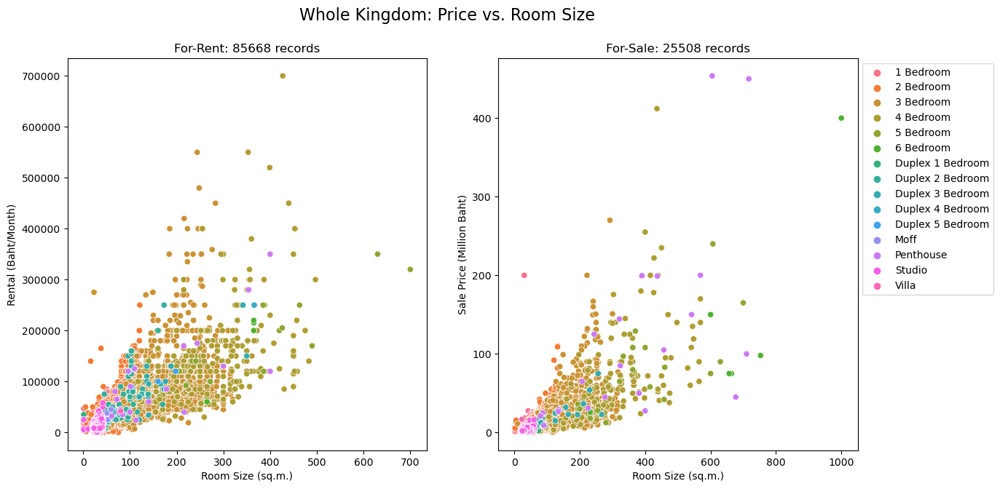

In [4]:
# prices vs room_size
IQR_factor = 1.5
df_rent_temp = EDA.room_rent_cln
df_sale_temp = EDA.room_sale_cln
df_rent = pd.DataFrame({})
df_sale = pd.DataFrame({})

unit_types = df_rent_temp.groupby(by="unit_type")['unit_type'].count().index.values
for unit_type in unit_types:
    df_unit_temp = df_rent_temp[df_rent_temp['unit_type']==unit_type]
    if len(df_unit_temp):
        Q1 = df_unit_temp['room_size'].quantile(0.25)
        Q3 = df_unit_temp['room_size'].quantile(0.75)
        IQR = Q3-Q1
        upper = Q3+IQR_factor*IQR
        df_unit_temp = df_unit_temp[(df_unit_temp['room_size']<=upper)]
        df_rent = pd.concat([df_rent,df_unit_temp],axis=0)
df_rent.reset_index(inplace=True, drop=True)
df_rent_plot = df_rent

unit_types = df_sale_temp.groupby(by="unit_type")['unit_type'].count().index.values
for unit_type in unit_types:
    df_unit_temp = df_sale_temp[df_sale_temp['unit_type']==unit_type]
    if len(df_unit_temp):
        Q1 = df_unit_temp['room_size'].quantile(0.25)
        Q3 = df_unit_temp['room_size'].quantile(0.75)
        IQR = Q3-Q1
        upper = Q3+IQR_factor*IQR
        df_unit_temp = df_unit_temp[(df_unit_temp['room_size']<=upper)]
        df_sale = pd.concat([df_sale,df_unit_temp],axis=0)
df_sale.reset_index(inplace=True, drop=True)
df_sale_plot = df_sale

fig, axes = plt.subplots(1, 2, figsize=(14, 7))
fig.suptitle('Whole Kingdom: Price vs. Room Size \n', fontsize=16)
hue_order = sorted(df_rent_plot['unit_type'].unique())

line1 = sns.scatterplot(ax=axes[0], data=df_rent_plot, x="room_size", y="price", hue='unit_type', hue_order=hue_order)
axes[0].set_title(f'For-Rent: {len(df_rent_plot)} records')
axes[0].set(xlabel='Room Size (sq.m.)', ylabel='Rental (Baht/Month)')
axes[0].legend([], [], frameon=False);

df_sale_plot['price'] = df_sale_plot['price']/1000000
line2 = sns.scatterplot(ax=axes[1], data=df_sale_plot, x="room_size", y="price", hue='unit_type', hue_order=hue_order)
axes[1].set_title(f'For-Sale: {len(df_sale_plot)} records')
axes[1].set(xlabel='Room Size (sq.m.)', ylabel='Sale Price (Million Baht)')
axes[1].legend(bbox_to_anchor=(1,1));

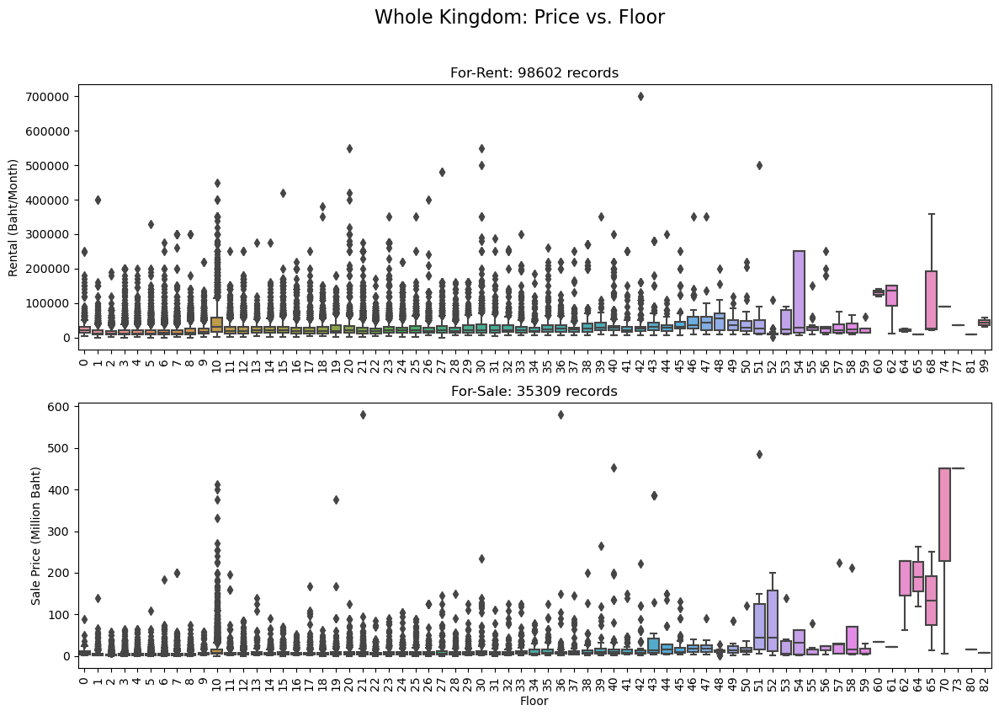

In [5]:
# prices vs floor
df_rent_plot = EDA.room_rent_cln
df_sale_plot = EDA.room_sale_cln
df_rent_plot.dropna(subset = ['floor'], inplace=True)
df_sale_plot.dropna(subset = ['floor'], inplace=True)
df_rent_plot = df_rent_plot.astype({'floor': 'int32'})
df_sale_plot = df_sale_plot.astype({'floor': 'int32'})

fig, axes = plt.subplots(2, 1, figsize=(14, 9))
fig.suptitle('Whole Kingdom: Price vs. Floor', fontsize=16)

box1 = sns.boxplot(ax=axes[0], data=df_rent_plot, x ="floor",y ="price")
axes[0].set_title(f'For-Rent: {len(df_rent_plot)} records')
axes[0].set(xlabel='', ylabel='Rental (Baht/Month)')
plt.sca(axes[0])
plt.xticks(rotation=90);

df_sale_plot['price'] = df_sale_plot['price']/1000000
box2 = sns.boxplot(ax=axes[1], data=df_sale_plot, x ="floor",y ="price")
axes[1].set_title(f'For-Sale: {len(df_sale_plot)} records')
axes[1].set(xlabel='Floor', ylabel='Sale Price (Million Baht)')
plt.sca(axes[1])
plt.xticks(rotation=90);

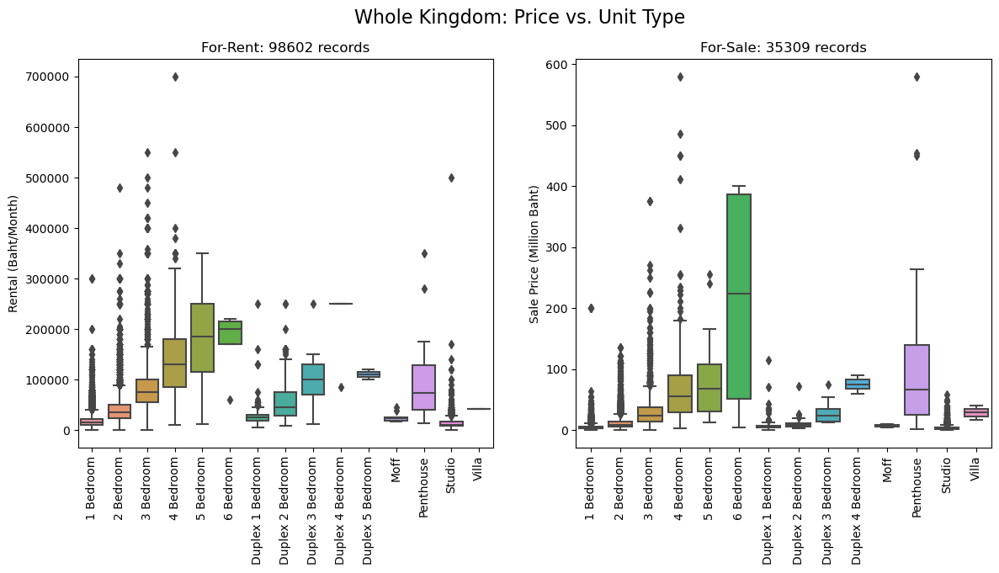

In [6]:
df_rent_plot = EDA.room_rent_cln.sort_values(by=['unit_type'])
df_sale_plot = EDA.room_sale_cln.sort_values(by=['unit_type'])

fig, axes = plt.subplots(1, 2, figsize=(14, 6))
fig.suptitle('Whole Kingdom: Price vs. Unit Type', fontsize=16)

box1 = sns.boxplot(ax=axes[0], data=df_rent_plot, x ="unit_type",y ="price")
axes[0].set_title(f'For-Rent: {len(df_rent_plot)} records')
axes[0].set(xlabel='', ylabel='Rental (Baht/Month)')
plt.sca(axes[0])
plt.xticks(rotation=90);

df_sale_plot['price'] = df_sale_plot['price']/1000000
box2 = sns.boxplot(ax=axes[1], data=df_sale_plot, x ="unit_type",y ="price")
axes[1].set_title(f'For-Sale: {len(df_sale_plot)} records')
axes[1].set(xlabel='', ylabel='Sale Price (Million Baht)')
plt.sca(axes[1])
plt.xticks(rotation=90);

In [7]:
df_rent_unit = pd.DataFrame()
df_rent_unit['unit_type'] = EDA.room_rent_cln.groupby(by="unit_type")['unit_type'].count().index.tolist()
df_rent_unit['record_no'] = EDA.room_rent_cln.groupby(by="unit_type")['unit_type'].count().values.tolist()
df_rent_unit.sort_values(by='record_no', ascending=False, inplace=True)
df_rent_unit.set_index('unit_type', inplace=True)
print('For-Rent')
print(df_rent_unit)
print(f"Total:                {df_rent_unit['record_no'].sum()}")
print('')
print('')
df_sale_unit = pd.DataFrame()
df_sale_unit['unit_type'] = EDA.room_sale_cln.groupby(by="unit_type")['unit_type'].count().index.tolist()
df_sale_unit['record_no'] = EDA.room_sale_cln.groupby(by="unit_type")['unit_type'].count().values.tolist()
df_sale_unit.sort_values(by='record_no', ascending=False, inplace=True)
df_sale_unit.set_index('unit_type', inplace=True)
print('For-Sale')
print(df_sale_unit)
print(f"Total:                {df_sale_unit['record_no'].sum()}")

For-Rent
                  record_no
unit_type                  
1 Bedroom             68732
2 Bedroom             19797
Studio                 6641
3 Bedroom              2084
Duplex 1 Bedroom        795
4 Bedroom               297
Duplex 2 Bedroom        168
Penthouse                30
Duplex 3 Bedroom         19
5 Bedroom                16
Moff                     10
6 Bedroom                 5
Duplex 4 Bedroom          5
Duplex 5 Bedroom          2
Villa                     1
Total:                98602


For-Sale
                  record_no
unit_type                  
1 Bedroom             21606
2 Bedroom              8132
Studio                 3733
3 Bedroom              1403
4 Bedroom               202
Duplex 1 Bedroom         95
Duplex 2 Bedroom         38
5 Bedroom                36
Penthouse                34
6 Bedroom                11
Duplex 3 Bedroom         11
Moff                      4
Duplex 4 Bedroom          2
Villa                     2
Total:                35309


In [8]:
# 1BR & Studio
avg_price = []
room_rent = EDA.room_rent_cln
room_rent = room_rent[(room_rent['unit_type']=='1 Bedroom') | (room_rent['unit_type']=='Studio')]
for condo in EDA.project['project_name']:
    room_rent_temp = room_rent[room_rent['project_name']==condo]
    if len(room_rent_temp):
        avg_price.append(room_rent_temp['price'].mean())
    else:
        avg_price.append(np.nan)
        
EDA.project['avg_price_rent_1BR_studio'] = avg_price

avg_price = []
room_sale = EDA.room_sale_cln
room_sale = room_sale[(room_sale['unit_type']=='1 Bedroom') | (room_sale['unit_type']=='Studio')]
for condo in EDA.project['project_name']:
    room_sale_temp = room_sale[room_sale['project_name']==condo]
    if len(room_sale_temp):
        avg_price.append(room_sale_temp['price'].mean())
    else:
        avg_price.append(np.nan)
        
EDA.project['avg_price_sale_1BR_studio'] = avg_price

In [9]:
# 2BR
avg_price = []
room_rent = EDA.room_rent_cln
room_rent = room_rent[(room_rent['unit_type']=='2 Bedroom')]
for condo in EDA.project['project_name']:
    room_rent_temp = room_rent[room_rent['project_name']==condo]
    if len(room_rent_temp):
        avg_price.append(room_rent_temp['price'].mean())
    else:
        avg_price.append(np.nan)
        
EDA.project['avg_price_rent_2BR'] = avg_price

avg_price = []
room_sale = EDA.room_sale_cln
room_sale = room_sale[(room_sale['unit_type']=='2 Bedroom')]
for condo in EDA.project['project_name']:
    room_sale_temp = room_sale[room_sale['project_name']==condo]
    if len(room_sale_temp):
        avg_price.append(room_sale_temp['price'].mean())
    else:
        avg_price.append(np.nan)
        
EDA.project['avg_price_sale_2BR'] = avg_price

In [10]:
# For-rent: 1BR & Studio
map_obj = folium.Map(width=500, height=450, location = [13.892786811659525, 101.05717811879971], zoom_start = 5, tiles = "CartoDB Positron") # openstreetmap
map_data = EDA.project[['lat','lon','avg_price_rent_1BR_studio']]
max_cap = 60000
map_data.loc[map_data['avg_price_rent_1BR_studio']>=max_cap,'avg_price_rent_1BR_studio'] = max_cap
map_data['avg_price_rent_1BR_studio'] = map_data['avg_price_rent_1BR_studio']/max_cap
map_data.dropna(subset = ['avg_price_rent_1BR_studio'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geojson_url = "https://raw.githubusercontent.com/apisit/thailand.json/master/thailandwithdensity.json"
style = {'fillColor': 'yellow', 'fillOpacity': 0.1, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geojson_url, name = "geojson",
    style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f'Whole Kingdom: Normalized Average Monthly Rental - 1 Bedroom & Studio ({len(map_data)} records)'
colormap.add_to(map_obj)

HeatMap(data,
        gradient=gradient_map,
        radius=20).add_to(map_obj)

map_data = map_data[['lat','lon']]
for i in range(len(map_data)):
    folium.CircleMarker(map_data.iloc[i,:].values.tolist(),
                    radius=1,
                    color='cadetblue').add_to(map_obj)

map_obj

In [11]:
# For-rent: 2 BR
map_obj = folium.Map(width=500, height=450, location = [13.892786811659525, 101.05717811879971], zoom_start = 5, tiles = "CartoDB Positron") # openstreetmap
map_data = EDA.project[['lat','lon','avg_price_sale_2BR']]
max_cap = 100000
map_data.loc[map_data['avg_price_sale_2BR']>=max_cap,'avg_price_sale_2BR'] = max_cap
map_data['avg_price_sale_2BR'] = map_data['avg_price_sale_2BR']/max_cap
map_data.dropna(subset = ['avg_price_sale_2BR'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geojson_url = "https://raw.githubusercontent.com/apisit/thailand.json/master/thailandwithdensity.json"
style = {'fillColor': 'yellow', 'fillOpacity': 0.1, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geojson_url, name = "geojson",
    style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f'Whole Kingdom: Normalized Average Monthly Rental - 2 Bedroom ({len(map_data)} records)'
colormap.add_to(map_obj)

HeatMap(data,
        gradient=gradient_map,
        radius=20).add_to(map_obj)

map_data = map_data[['lat','lon']]
for i in range(len(map_data)):
    folium.CircleMarker(map_data.iloc[i,:].values.tolist(),
                    radius=1,
                    color='cadetblue').add_to(map_obj)

map_obj

In [12]:
# For-sale: 1 BR & Studio
map_obj = folium.Map(width=500, height=450, location = [13.892786811659525, 101.05717811879971], zoom_start = 5, tiles = "CartoDB Positron") # openstreetmap
map_data = EDA.project[['lat','lon','avg_price_sale_1BR_studio']]
max_cap = 20000000
map_data.loc[map_data['avg_price_sale_1BR_studio']>=max_cap,'avg_price_sale_1BR_studio'] = max_cap
map_data['avg_price_sale_1BR_studio'] = map_data['avg_price_sale_1BR_studio']/max_cap
map_data.dropna(subset = ['avg_price_sale_1BR_studio'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geojson_url = "https://raw.githubusercontent.com/apisit/thailand.json/master/thailandwithdensity.json"
style = {'fillColor': 'yellow', 'fillOpacity': 0.1, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geojson_url, name = "geojson",
    style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f'Whole Kingdom: Normalized Average Sale Price - 1 Bedroom & Studio ({len(map_data)} records)'
colormap.add_to(map_obj)

HeatMap(data,
        gradient=gradient_map,
        radius=20).add_to(map_obj)

map_data = map_data[['lat','lon']]
for i in range(len(map_data)):
    folium.CircleMarker(map_data.iloc[i,:].values.tolist(),
                    radius=1,
                    color='cadetblue').add_to(map_obj)

map_obj

In [13]:
# For-sale: 2 BR
map_obj = folium.Map(width=500, height=450, location = [13.892786811659525, 101.05717811879971], zoom_start = 5, tiles = "CartoDB Positron") # openstreetmap
map_data = EDA.project[['lat','lon','avg_price_sale_2BR']]
max_cap = 20000000
map_data.loc[map_data['avg_price_sale_2BR']>=max_cap,'avg_price_sale_2BR'] = max_cap
map_data['avg_price_sale_2BR'] = map_data['avg_price_sale_2BR']/max_cap
map_data.dropna(subset = ['avg_price_sale_2BR'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geojson_url = "https://raw.githubusercontent.com/apisit/thailand.json/master/thailandwithdensity.json"
style = {'fillColor': 'yellow', 'fillOpacity': 0.1, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geojson_url, name = "geojson",
    style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f'Whole Kingdom: Normalized Average Sale Price - 2 Bedroom ({len(map_data)} records)'
colormap.add_to(map_obj)

HeatMap(data,
        gradient=gradient_map,
        radius=20).add_to(map_obj)

map_data = map_data[['lat','lon']]
for i in range(len(map_data)):
    folium.CircleMarker(map_data.iloc[i,:].values.tolist(),
                    radius=1,
                    color='cadetblue').add_to(map_obj)

map_obj

In [14]:
# Join districts and provinces to room_rent table 
districts = []
provinces = []
df_rent_temp = EDA.room_rent_cln
df_rent_temp.reset_index(inplace=True, drop=True)
for i in range(len(df_rent_temp)):
    district = EDA.project.loc[EDA.project['project_name']==df_rent_temp['project_name'][i],'district'].values[0]
    province = EDA.project.loc[EDA.project['project_name']==df_rent_temp['project_name'][i],'province'].values[0]
    districts.append(district)
    provinces.append(province)
df_rent_temp['district'] = districts
df_rent_temp['province'] = provinces

# Join districts and provinces to room_sale table 
districts = []
provinces = []
df_sale_temp = EDA.room_sale_cln
df_sale_temp.reset_index(inplace=True, drop=True)
for i in range(len(df_sale_temp)):
    district = EDA.project.loc[EDA.project['project_name']==df_sale_temp['project_name'][i],'district'].values[0]
    province = EDA.project.loc[EDA.project['project_name']==df_sale_temp['project_name'][i],'province'].values[0]
    districts.append(district)
    provinces.append(province)
df_sale_temp['district'] = districts
df_sale_temp['province'] = provinces

df_rent_prov = pd.DataFrame()
df_rent_prov['province'] = df_rent_temp.groupby(by="province")['province'].count().index.tolist()
df_rent_prov['record_no'] = df_rent_temp.groupby(by="province")['province'].count().values.tolist()
df_rent_prov.sort_values(by='record_no', ascending=False, inplace=True)
df_rent_prov.set_index('province', inplace=True)
print('For-Rent')
print(df_rent_prov)
print(f"Total:                        {df_rent_prov['record_no'].sum()}")
print('')
print('')
df_sale_prov = pd.DataFrame()
df_sale_prov['province'] = df_sale_temp.groupby(by="province")['province'].count().index.tolist()
df_sale_prov['record_no'] = df_sale_temp.groupby(by="province")['province'].count().values.tolist()
df_sale_prov.sort_values(by='record_no', ascending=False, inplace=True)
df_sale_prov.set_index('province', inplace=True)
print('For-Sale')
print(df_sale_prov)
print(f"Total:                        {df_sale_prov['record_no'].sum()}")

# 1st Bangkok
# 2nd Nonthaburi
# 3rd Samut Prakan
# 4th Chonburi
# 5th Phuket
# 6th Chiang Mai

For-Rent
                          record_no
province                           
Bangkok                       86346
Nonthaburi                     5060
Samut Prakan                   3540
Chonburi                       1979
Pathum Thani                    478
Chiang Mai                      332
Phuket                          240
Nakhon Pathom                   198
Rayong                          162
Prachuap Khiri Khan              69
Nakhon Ratchasima                55
Songkhla                         23
Phetchaburi                      19
Phra Nakhon Si Ayutthaya         18
Khon Kaen                        17
Udon Thani                       14
Samut Sakhon                      9
Ubon Ratchathani                  8
Surat Thani                       7
Chiang Rai                        5
Nakhon Sawan                      4
Phitsanulok                       4
Lampang                           4
Chachoengsao                      4
Buriram                           3
Prachinburi        

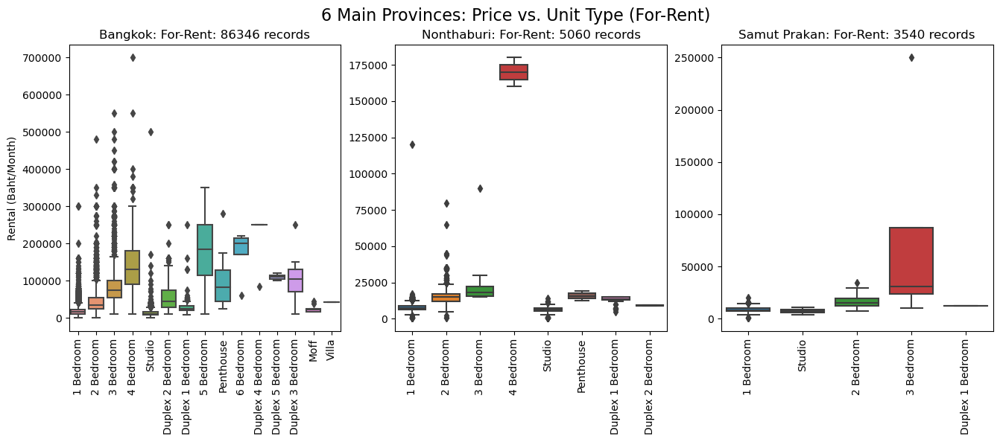

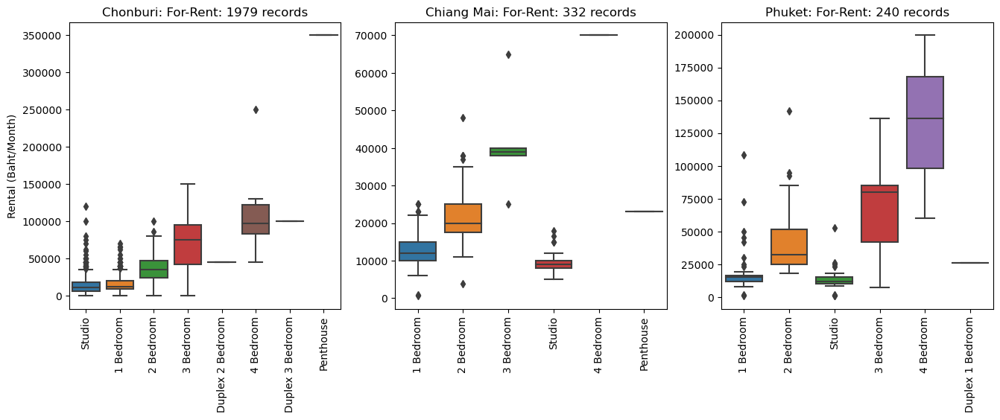

In [15]:
df_rent_plot_1 = df_rent_temp[df_rent_temp['province']=='Bangkok']
df_rent_plot_2 = df_rent_temp[df_rent_temp['province']=='Nonthaburi']
df_rent_plot_3 = df_rent_temp[df_rent_temp['province']=='Samut Prakan']
df_rent_plot_4 = df_rent_temp[df_rent_temp['province']=='Chonburi']
df_rent_plot_5 = df_rent_temp[df_rent_temp['province']=='Chiang Mai']
df_rent_plot_6 = df_rent_temp[df_rent_temp['province']=='Phuket']

fig, axes = plt.subplots(1, 3, figsize=(16, 5))
fig.suptitle('6 Main Provinces: Price vs. Unit Type (For-Rent)', fontsize=16)

box1 = sns.boxplot(ax=axes[0], data=df_rent_plot_1, x ="unit_type",y ="price")
axes[0].set_title(f'Bangkok: For-Rent: {len(df_rent_plot_1)} records')
axes[0].set(xlabel='', ylabel='Rental (Baht/Month)')
plt.sca(axes[0])
plt.xticks(rotation=90);

box2 = sns.boxplot(ax=axes[1], data=df_rent_plot_2, x ="unit_type",y ="price")
axes[1].set_title(f'Nonthaburi: For-Rent: {len(df_rent_plot_2)} records')
axes[1].set(xlabel='', ylabel='')
plt.sca(axes[1])
plt.xticks(rotation=90);

box3 = sns.boxplot(ax=axes[2], data=df_rent_plot_3, x ="unit_type",y ="price")
axes[2].set_title(f'Samut Prakan: For-Rent: {len(df_rent_plot_3)} records')
axes[2].set(xlabel='', ylabel='')
plt.sca(axes[2])
plt.xticks(rotation=90);

fig, axes = plt.subplots(1, 3, figsize=(16, 5))

box4 = sns.boxplot(ax=axes[0], data=df_rent_plot_4, x ="unit_type",y ="price")
axes[0].set_title(f'Chonburi: For-Rent: {len(df_rent_plot_4)} records')
axes[0].set(xlabel='', ylabel='Rental (Baht/Month)')
plt.sca(axes[0])
plt.xticks(rotation=90);

box5 = sns.boxplot(ax=axes[1], data=df_rent_plot_5, x ="unit_type",y ="price")
axes[1].set_title(f'Chiang Mai: For-Rent: {len(df_rent_plot_5)} records')
axes[1].set(xlabel='', ylabel='')
plt.sca(axes[1])
plt.xticks(rotation=90);

box6 = sns.boxplot(ax=axes[2], data=df_rent_plot_6, x ="unit_type",y ="price")
axes[2].set_title(f'Phuket: For-Rent: {len(df_rent_plot_6)} records')
axes[2].set(xlabel='', ylabel='')
plt.sca(axes[2])
plt.xticks(rotation=90);

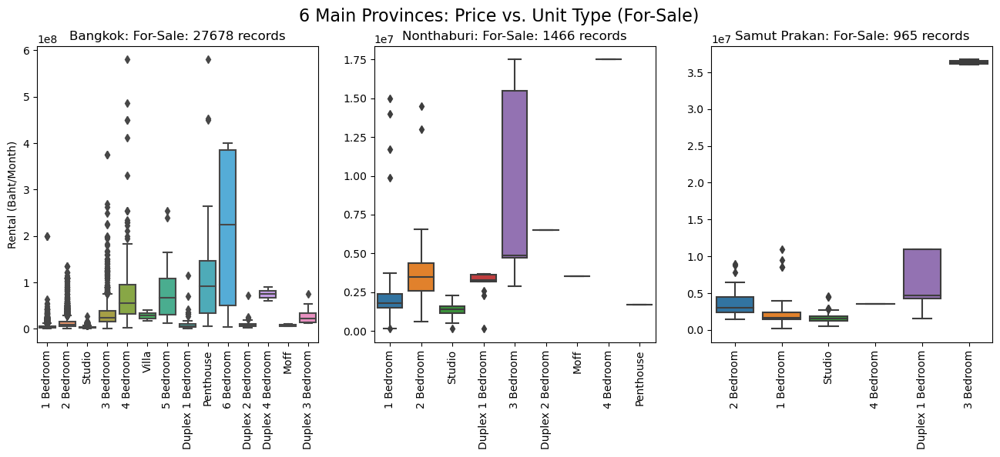

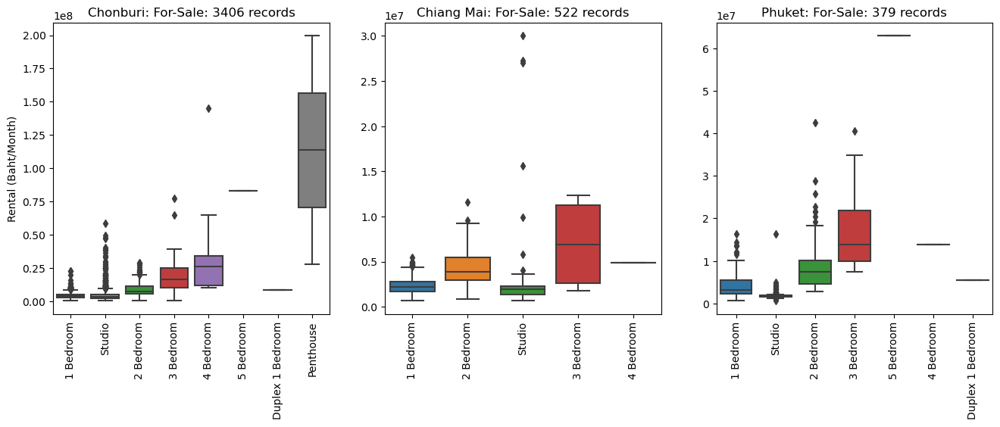

In [16]:
df_sale_plot_1 = df_sale_temp[df_sale_temp['province']=='Bangkok']
df_sale_plot_2 = df_sale_temp[df_sale_temp['province']=='Nonthaburi']
df_sale_plot_3 = df_sale_temp[df_sale_temp['province']=='Samut Prakan']
df_sale_plot_4 = df_sale_temp[df_sale_temp['province']=='Chonburi']
df_sale_plot_5 = df_sale_temp[df_sale_temp['province']=='Chiang Mai']
df_sale_plot_6 = df_sale_temp[df_sale_temp['province']=='Phuket']

fig, axes = plt.subplots(1, 3, figsize=(16, 5))
fig.suptitle('6 Main Provinces: Price vs. Unit Type (For-Sale)', fontsize=16)

box1 = sns.boxplot(ax=axes[0], data=df_sale_plot_1, x ="unit_type",y ="price")
axes[0].set_title(f'Bangkok: For-Sale: {len(df_sale_plot_1)} records')
axes[0].set(xlabel='', ylabel='Rental (Baht/Month)')
plt.sca(axes[0])
plt.xticks(rotation=90);

box2 = sns.boxplot(ax=axes[1], data=df_sale_plot_2, x ="unit_type",y ="price")
axes[1].set_title(f'Nonthaburi: For-Sale: {len(df_sale_plot_2)} records')
axes[1].set(xlabel='', ylabel='')
plt.sca(axes[1])
plt.xticks(rotation=90);

box3 = sns.boxplot(ax=axes[2], data=df_sale_plot_3, x ="unit_type",y ="price")
axes[2].set_title(f'Samut Prakan: For-Sale: {len(df_sale_plot_3)} records')
axes[2].set(xlabel='', ylabel='')
plt.sca(axes[2])
plt.xticks(rotation=90);

fig, axes = plt.subplots(1, 3, figsize=(16, 5))

box4 = sns.boxplot(ax=axes[0], data=df_sale_plot_4, x ="unit_type",y ="price")
axes[0].set_title(f'Chonburi: For-Sale: {len(df_sale_plot_4)} records')
axes[0].set(xlabel='', ylabel='Rental (Baht/Month)')
plt.sca(axes[0])
plt.xticks(rotation=90);

box5 = sns.boxplot(ax=axes[1], data=df_sale_plot_5, x ="unit_type",y ="price")
axes[1].set_title(f'Chiang Mai: For-Sale: {len(df_sale_plot_5)} records')
axes[1].set(xlabel='', ylabel='')
plt.sca(axes[1])
plt.xticks(rotation=90);

box6 = sns.boxplot(ax=axes[2], data=df_sale_plot_6, x ="unit_type",y ="price")
axes[2].set_title(f'Phuket: For-Sale: {len(df_sale_plot_6)} records')
axes[2].set(xlabel='', ylabel='')
plt.sca(axes[2])
plt.xticks(rotation=90);

In [17]:
# map of avg. prices in 6 main provinces vs. unit_types
# For-rent
room_rents = [df_rent_plot_1,df_rent_plot_2,df_rent_plot_3,df_rent_plot_4,df_rent_plot_5,df_rent_plot_6]
for i,room_rent in enumerate(room_rents):
    avg_price = []
    for condo in EDA.project['project_name']:
        room_rent_temp = room_rent[room_rent['project_name']==condo]
        if len(room_rent_temp):
            avg_price.append(room_rent_temp['price'].mean())
        else:
            avg_price.append(np.nan)
    EDA.project[f'avg_price_rent_{i+1}'] = avg_price

# For-sale
room_sales = [df_sale_plot_1,df_sale_plot_2,df_sale_plot_3,df_sale_plot_4,df_sale_plot_5,df_sale_plot_6]
for i,room_sale in enumerate(room_sales):
    avg_price = []
    for condo in EDA.project['project_name']:
        room_sale_temp = room_sale[room_sale['project_name']==condo]
        if len(room_sale_temp):
            avg_price.append(room_sale_temp['price'].mean())
        else:
            avg_price.append(np.nan)
    EDA.project[f'avg_price_sale_{i+1}'] = avg_price

In [18]:
# Bangkok For-Rent
map_obj = folium.Map(width=500, height=450, location = [13.7836717, 100.623186], zoom_start = 10, tiles = "openstreetmap")
map_data = EDA.project[['lat','lon','avg_price_rent_1']]
max_cap = 100000
map_data.loc[map_data['avg_price_rent_1']>=max_cap,'avg_price_rent_1'] = max_cap
map_data['avg_price_rent_1'] = map_data['avg_price_rent_1']/max_cap
map_data.dropna(subset = ['avg_price_rent_1'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geojson_url = "https://raw.githubusercontent.com/apisit/thailand.json/master/thailandwithdensity.json"
with urllib.request.urlopen(geojson_url) as url:
    geojson = json.loads(url.read().decode())
geojson_1 = {'type': 'FeatureCollection', 'features': [geojson['features'][2]]}
geojson_url = geojson_1
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geojson_url, name = "geojson",
    style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f'Bangkok: Normalized Average Monthly Rental - {len(map_data)} records'
colormap.add_to(map_obj)

HeatMap(data,
        gradient=gradient_map,
        radius=20).add_to(map_obj)

map_data = map_data[['lat','lon']]
for i in range(len(map_data)):
    folium.CircleMarker(map_data.iloc[i,:].values.tolist(),
                    radius=1,
                    color='cadetblue').add_to(map_obj)

map_obj

In [19]:
# Bangkok For-Sale
map_obj = folium.Map(width=500, height=450, location = [13.7536717, 100.623186], zoom_start = 10, tiles = "openstreetmap")
map_data = EDA.project[['lat','lon','avg_price_sale_1']]
max_cap = 20000000
map_data.loc[map_data['avg_price_sale_1']>=max_cap,'avg_price_sale_1'] = max_cap
map_data['avg_price_sale_1'] = map_data['avg_price_sale_1']/max_cap
map_data.dropna(subset = ['avg_price_sale_1'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geojson_url = "https://raw.githubusercontent.com/apisit/thailand.json/master/thailandwithdensity.json"
with urllib.request.urlopen(geojson_url) as url:
    geojson = json.loads(url.read().decode())
geojson_1 = {'type': 'FeatureCollection', 'features': [geojson['features'][2]]}
geojson_url = geojson_1
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geojson_url, name = "geojson",
    style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f'Bangkok: Normalized Average Sale Price - {len(map_data)} records'
colormap.add_to(map_obj)

HeatMap(data,
        gradient=gradient_map,
        radius=20).add_to(map_obj)

map_data = map_data[['lat','lon']]
for i in range(len(map_data)):
    folium.CircleMarker(map_data.iloc[i,:].values.tolist(),
                    radius=1,
                    color='cadetblue').add_to(map_obj)

map_obj

In [20]:
# Nonthaburi For-Rent
map_obj = folium.Map(width=500, height=450, location = [13.9608, 100.4148], zoom_start = 10, tiles = "openstreetmap")
map_data = EDA.project[['lat','lon','avg_price_rent_2']]
max_cap = 50000
map_data.loc[map_data['avg_price_rent_2']>=max_cap,'avg_price_rent_2'] = max_cap
map_data['avg_price_rent_2'] = map_data['avg_price_rent_2']/max_cap
map_data.dropna(subset = ['avg_price_rent_2'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geojson_url = "https://raw.githubusercontent.com/apisit/thailand.json/master/thailandwithdensity.json"
with urllib.request.urlopen(geojson_url) as url:
    geojson = json.loads(url.read().decode())
geojson_1 = {'type': 'FeatureCollection', 'features': [geojson['features'][34]]}
geojson_url = geojson_1
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geojson_url, name = "geojson",
    style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f'Nonthaburi: Normalized Average Monthly Rental - {len(map_data)} records'
colormap.add_to(map_obj)

HeatMap(data,
        gradient=gradient_map,
        radius=20).add_to(map_obj)

map_data = map_data[['lat','lon']]
for i in range(len(map_data)):
    folium.CircleMarker(map_data.iloc[i,:].values.tolist(),
                    radius=1,
                    color='cadetblue').add_to(map_obj)

map_obj

In [21]:
# Nonthaburi For-Sale
map_obj = folium.Map(width=500, height=450, location = [13.9608, 100.4148], zoom_start = 10, tiles = "openstreetmap")
map_data = EDA.project[['lat','lon','avg_price_sale_2']]
max_cap = 10000000
map_data.loc[map_data['avg_price_sale_2']>=max_cap,'avg_price_sale_2'] = max_cap
map_data['avg_price_sale_2'] = map_data['avg_price_sale_2']/max_cap
map_data.dropna(subset = ['avg_price_sale_2'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geojson_url = "https://raw.githubusercontent.com/apisit/thailand.json/master/thailandwithdensity.json"
with urllib.request.urlopen(geojson_url) as url:
    geojson = json.loads(url.read().decode())
geojson_1 = {'type': 'FeatureCollection', 'features': [geojson['features'][34]]}
geojson_url = geojson_1
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geojson_url, name = "geojson",
    style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f'Nonthaburi: Normalized Average Sale Price - {len(map_data)} records'
colormap.add_to(map_obj)

HeatMap(data,
        gradient=gradient_map,
        radius=20).add_to(map_obj)

map_data = map_data[['lat','lon']]
for i in range(len(map_data)):
    folium.CircleMarker(map_data.iloc[i,:].values.tolist(),
                    radius=1,
                    color='cadetblue').add_to(map_obj)

map_obj

In [22]:
# Samut Prakan For-Rent
map_obj = folium.Map(width=500, height=450, location = [13.5954, 100.7072], zoom_start = 10, tiles = "openstreetmap")
map_data = EDA.project[['lat','lon','avg_price_rent_3']]
max_cap = 50000
map_data.loc[map_data['avg_price_rent_3']>=max_cap,'avg_price_rent_3'] = max_cap
map_data['avg_price_rent_3'] = map_data['avg_price_rent_3']/max_cap
map_data.dropna(subset = ['avg_price_rent_3'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geojson_url = "https://raw.githubusercontent.com/apisit/thailand.json/master/thailandwithdensity.json"
with urllib.request.urlopen(geojson_url) as url:
    geojson = json.loads(url.read().decode())
geojson_1 = {'type': 'FeatureCollection', 'features': [geojson['features'][55]]}
geojson_url = geojson_1
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geojson_url, name = "geojson",
    style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f'Samut Prakan: Normalized Average Monthly Rental - {len(map_data)} records'
colormap.add_to(map_obj)

HeatMap(data,
        gradient=gradient_map,
        radius=20).add_to(map_obj)

map_data = map_data[['lat','lon']]
for i in range(len(map_data)):
    folium.CircleMarker(map_data.iloc[i,:].values.tolist(),
                    radius=1,
                    color='cadetblue').add_to(map_obj)

map_obj

In [23]:
# Samut Prakan For-Sale
map_obj = folium.Map(width=500, height=450, location = [13.5954, 100.7072], zoom_start = 10, tiles = "openstreetmap")
map_data = EDA.project[['lat','lon','avg_price_sale_3']]
max_cap = 10000000
map_data.loc[map_data['avg_price_sale_3']>=max_cap,'avg_price_sale_3'] = max_cap
map_data['avg_price_sale_3'] = map_data['avg_price_sale_3']/max_cap
map_data.dropna(subset = ['avg_price_sale_3'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geojson_url = "https://raw.githubusercontent.com/apisit/thailand.json/master/thailandwithdensity.json"
with urllib.request.urlopen(geojson_url) as url:
    geojson = json.loads(url.read().decode())
geojson_1 = {'type': 'FeatureCollection', 'features': [geojson['features'][55]]}
geojson_url = geojson_1
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geojson_url, name = "geojson",
    style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f'Samut Prakan: Normalized Average Sale Price - {len(map_data)} records'
colormap.add_to(map_obj)

HeatMap(data,
        gradient=gradient_map,
        radius=20).add_to(map_obj)

map_data = map_data[['lat','lon']]
for i in range(len(map_data)):
    folium.CircleMarker(map_data.iloc[i,:].values.tolist(),
                    radius=1,
                    color='cadetblue').add_to(map_obj)

map_obj

In [24]:
# Chonburi For-Rent
map_obj = folium.Map(width=500, height=450, location = [13.1817, 101.2524], zoom_start = 9, tiles = "openstreetmap")
map_data = EDA.project[['lat','lon','avg_price_rent_4']]
max_cap = 50000
map_data.loc[map_data['avg_price_rent_4']>=max_cap,'avg_price_rent_4'] = max_cap
map_data['avg_price_rent_4'] = map_data['avg_price_rent_4']/max_cap
map_data.dropna(subset = ['avg_price_rent_4'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geojson_url = "https://raw.githubusercontent.com/apisit/thailand.json/master/thailandwithdensity.json"
with urllib.request.urlopen(geojson_url) as url:
    geojson = json.loads(url.read().decode())
geojson_1 = {'type': 'FeatureCollection', 'features': [geojson['features'][10]]}
geojson_url = geojson_1
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geojson_url, name = "geojson",
    style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f'Chonburi: Normalized Average Monthly Rental - {len(map_data)} records'
colormap.add_to(map_obj)

HeatMap(data,
        gradient=gradient_map,
        radius=20).add_to(map_obj)

map_data = map_data[['lat','lon']]
for i in range(len(map_data)):
    folium.CircleMarker(map_data.iloc[i,:].values.tolist(),
                    radius=1,
                    color='cadetblue').add_to(map_obj)

map_obj

In [25]:
# Chonburi For-Sale
map_obj = folium.Map(width=500, height=450, location = [13.1817, 101.2524], zoom_start = 9, tiles = "openstreetmap")
map_data = EDA.project[['lat','lon','avg_price_sale_4']]
max_cap = 10000000
map_data.loc[map_data['avg_price_sale_4']>=max_cap,'avg_price_sale_4'] = max_cap
map_data['avg_price_sale_4'] = map_data['avg_price_sale_4']/max_cap
map_data.dropna(subset = ['avg_price_sale_4'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geojson_url = "https://raw.githubusercontent.com/apisit/thailand.json/master/thailandwithdensity.json"
with urllib.request.urlopen(geojson_url) as url:
    geojson = json.loads(url.read().decode())
geojson_1 = {'type': 'FeatureCollection', 'features': [geojson['features'][10]]}
geojson_url = geojson_1
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geojson_url, name = "geojson",
    style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f'Chonburi: Normalized Average Sale Price - {len(map_data)} records'
colormap.add_to(map_obj)

HeatMap(data,
        gradient=gradient_map,
        radius=20).add_to(map_obj)

map_data = map_data[['lat','lon']]
for i in range(len(map_data)):
    folium.CircleMarker(map_data.iloc[i,:].values.tolist(),
                    radius=1,
                    color='cadetblue').add_to(map_obj)

map_obj

In [26]:
# Chiang Mai For-Rent
map_obj = folium.Map(width=500, height=450, location = [18.7943, 98.9853], zoom_start = 11.5, tiles = "openstreetmap")
map_data = EDA.project[['lat','lon','avg_price_rent_5']]
max_cap = 20000
map_data.loc[map_data['avg_price_rent_5']>=max_cap,'avg_price_rent_5'] = max_cap
map_data['avg_price_rent_5'] = map_data['avg_price_rent_5']/max_cap
map_data.dropna(subset = ['avg_price_rent_5'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geojson_url = "https://raw.githubusercontent.com/apisit/thailand.json/master/thailandwithdensity.json"
with urllib.request.urlopen(geojson_url) as url:
    geojson = json.loads(url.read().decode())
geojson_1 = {'type': 'FeatureCollection', 'features': [geojson['features'][8]]}
geojson_url = geojson_1
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geojson_url, name = "geojson",
    style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f'Chiang Mai: Normalized Average Monthly Rental - {len(map_data)} records'
colormap.add_to(map_obj)

HeatMap(data,
        gradient=gradient_map,
        radius=20).add_to(map_obj)

map_data = map_data[['lat','lon']]
for i in range(len(map_data)):
    folium.CircleMarker(map_data.iloc[i,:].values.tolist(),
                    radius=1,
                    color='cadetblue').add_to(map_obj)

map_obj

In [27]:
# Chiang Mai For-Sale
map_obj = folium.Map(width=500, height=450, location = [18.7943, 98.9853], zoom_start = 11.5, tiles = "openstreetmap")
map_data = EDA.project[['lat','lon','avg_price_sale_5']]
max_cap = 2000000
map_data.loc[map_data['avg_price_sale_5']>=max_cap,'avg_price_sale_5'] = max_cap
map_data['avg_price_sale_5'] = map_data['avg_price_sale_5']/max_cap
map_data.dropna(subset = ['avg_price_sale_5'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geojson_url = "https://raw.githubusercontent.com/apisit/thailand.json/master/thailandwithdensity.json"
with urllib.request.urlopen(geojson_url) as url:
    geojson = json.loads(url.read().decode())
geojson_1 = {'type': 'FeatureCollection', 'features': [geojson['features'][8]]}
geojson_url = geojson_1
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geojson_url, name = "geojson",
    style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f'Chiang Mai: Normalized Average Sale Price - {len(map_data)} records'
colormap.add_to(map_obj)

HeatMap(data,
        gradient=gradient_map,
        radius=20).add_to(map_obj)

map_data = map_data[['lat','lon']]
for i in range(len(map_data)):
    folium.CircleMarker(map_data.iloc[i,:].values.tolist(),
                    radius=1,
                    color='cadetblue').add_to(map_obj)

map_obj

In [28]:
#  For-Rent
map_obj = folium.Map(width=500, height=450, location = [7.9804, 98.3923], zoom_start = 10, tiles = "openstreetmap")
map_data = EDA.project[['lat','lon','avg_price_rent_6']]
max_cap = 50000
map_data.loc[map_data['avg_price_rent_6']>=max_cap,'avg_price_rent_6'] = max_cap
map_data['avg_price_rent_6'] = map_data['avg_price_rent_6']/max_cap
map_data.dropna(subset = ['avg_price_rent_6'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geojson_url = "https://raw.githubusercontent.com/apisit/thailand.json/master/thailandwithdensity.json"
with urllib.request.urlopen(geojson_url) as url:
    geojson = json.loads(url.read().decode())
geojson_1 = {'type': 'FeatureCollection', 'features': [geojson['features'][47]]}
geojson_url = geojson_1
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geojson_url, name = "geojson",
    style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f'Phuket: Normalized Average Monthly Rental - {len(map_data)} records'
colormap.add_to(map_obj)

HeatMap(data,
        gradient=gradient_map,
        radius=20).add_to(map_obj)

map_data = map_data[['lat','lon']]
for i in range(len(map_data)):
    folium.CircleMarker(map_data.iloc[i,:].values.tolist(),
                    radius=1,
                    color='cadetblue').add_to(map_obj)

map_obj

In [29]:
# Phuket For-Sale
map_obj = folium.Map(width=500, height=450, location = [7.9804, 98.3923], zoom_start = 10, tiles = "openstreetmap")
map_data = EDA.project[['lat','lon','avg_price_sale_6']]
max_cap = 10000000
map_data.loc[map_data['avg_price_sale_6']>=max_cap,'avg_price_sale_6'] = max_cap
map_data['avg_price_sale_6'] = map_data['avg_price_sale_6']/max_cap
map_data.dropna(subset = ['avg_price_sale_6'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geojson_url = "https://raw.githubusercontent.com/apisit/thailand.json/master/thailandwithdensity.json"
with urllib.request.urlopen(geojson_url) as url:
    geojson = json.loads(url.read().decode())
geojson_1 = {'type': 'FeatureCollection', 'features': [geojson['features'][47]]}
geojson_url = geojson_1
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geojson_url, name = "geojson",
    style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f'Phuket: Normalized Average Sale Price - {len(map_data)} records'
colormap.add_to(map_obj)

HeatMap(data,
        gradient=gradient_map,
        radius=20).add_to(map_obj)

map_data = map_data[['lat','lon']]
for i in range(len(map_data)):
    folium.CircleMarker(map_data.iloc[i,:].values.tolist(),
                    radius=1,
                    color='cadetblue').add_to(map_obj)

map_obj

In [30]:
# map of avg. prices in Bangkok for 1BR & Studio and 2 BR
geo_path = '/kaggle/input/geojson-th/Geojson_Files/Bangkok-district.geojson'
geo_bkk_district = json.load(open(geo_path))
df_district_bkk = pd.DataFrame(sorted(EDA.project[EDA.project['province']=='Bangkok']['district'].unique()))
df_district_bkk.columns = ['district']

# Fix wrong names
geo_bkk_district['features'][2]['properties']['dname_e'] = 'Wang Thonglang'
geo_bkk_district['features'][14]['properties']['dname_e'] = 'Pathum Wan'
geo_bkk_district['features'][16]['properties']['dname_e'] = 'Suan Luang'
geo_bkk_district['features'][17]['properties']['dname_e'] = 'Watthana'
geo_bkk_district['features'][22]['properties']['dname_e'] = 'Thon Buri'
geo_bkk_district['features'][24]['properties']['dname_e'] = 'Prawet'
geo_bkk_district['features'][28]['properties']['dname_e'] = 'Yan Nawa'
geo_bkk_district['features'][30]['properties']['dname_e'] = 'Bang Kho Laem'
geo_bkk_district['features'][35]['properties']['dname_e'] = 'Bang Khun Thian'
geo_bkk_district['features'][42]['properties']['dname_e'] = 'Chatuchak'
geo_bkk_district['features'][49]['properties']['dname_e'] = 'Thung Khru'

def style_function(feature):
    district = feature['properties']['dname_e']
    df_avg_value = df_district_bkk.loc[df_district_bkk['district']==district,'avg_price']
    if len(df_avg_value):
        return {
            'fillColor': colormap(df_avg_value.values[0]),
            'fillOpacity': 0.6,
            'color': 'blueviolet',
            'weight': 0.6}
    else:
        return {
            'fillColor': '#gray',
            'fillOpacity': 0.2,
            'color': 'blueviolet',
            'weight': 0.6}

In [31]:
# For-Rent, 1BR & Studio
room_rent = df_rent_temp[df_rent_temp['province']=='Bangkok']
room_rent = room_rent[(room_rent['unit_type']=='1 Bedroom') | (room_rent['unit_type']=='Studio')]
avg_price = []
for d in df_district_bkk['district']:
    room_rent_temp = room_rent[room_rent['district']==d]
    if len(room_rent_temp):
        avg_price.append(room_rent_temp['price'].mean())
    else:
        avg_price.append(np.nan)
df_district_bkk['avg_price'] = avg_price
df_district_bkk.dropna(inplace=True)
df_district_bkk.reset_index(inplace=True, drop=True)

map_obj = folium.Map(width=500, height=450, location = [13.766717, 100.623186], zoom_start = 10, tiles = "CartoDB Positron")
folium.GeoJson(data = geo_bkk_district, name = "geojson", style_function = style_function).add_to(map_obj)

colormap = cm.linear.YlOrRd_09.scale(0, df_district_bkk['avg_price'].max())
colormap = colormap.to_step(10)
colormap.caption = f"Bangkok: Average Monthly Rental in THB for 1 Bedroom & Studio Units - {len(room_rent)} records"
colormap.add_to(map_obj)

map_obj

In [32]:
# For-Sale, 1BR & Studio
room_sale = df_sale_temp[df_sale_temp['province']=='Bangkok']
room_sale = room_sale[(room_sale['unit_type']=='1 Bedroom') | (room_sale['unit_type']=='Studio')]
avg_price = []
for d in df_district_bkk['district']:
    room_sale_temp = room_sale[room_sale['district']==d]
    if len(room_sale_temp):
        avg_price.append(room_sale_temp['price'].mean())
    else:
        avg_price.append(np.nan)
df_district_bkk['avg_price'] = avg_price
df_district_bkk.dropna(inplace=True)
df_district_bkk.reset_index(inplace=True, drop=True)

map_obj = folium.Map(width=500, height=450, location = [13.766717, 100.623186], zoom_start = 10, tiles = "CartoDB Positron")
folium.GeoJson(data = geo_bkk_district, name = "geojson", style_function = style_function).add_to(map_obj)

colormap = cm.linear.YlOrRd_09.scale(0, df_district_bkk['avg_price'].max())
colormap = colormap.to_step(10)
colormap.caption = f"Bangkok: Average Sale Price in THB for 1 Bedroom & Studio Units - {len(room_sale)} records"
colormap.add_to(map_obj)

map_obj

In [33]:
# For-Rent, 2BR
room_rent = df_rent_temp[df_rent_temp['province']=='Bangkok']
room_rent = room_rent[(room_rent['unit_type']=='2 Bedroom')]
avg_price = []
for d in df_district_bkk['district']:
    room_rent_temp = room_rent[room_rent['district']==d]
    if len(room_rent_temp):
        avg_price.append(room_rent_temp['price'].mean())
    else:
        avg_price.append(np.nan)
df_district_bkk['avg_price'] = avg_price
df_district_bkk.dropna(inplace=True)
df_district_bkk.reset_index(inplace=True, drop=True)

map_obj = folium.Map(width=500, height=450, location = [13.766717, 100.623186], zoom_start = 10, tiles = "CartoDB Positron")
folium.GeoJson(data = geo_bkk_district, name = "geojson", style_function = style_function).add_to(map_obj)

colormap = cm.linear.YlOrRd_09.scale(0, df_district_bkk['avg_price'].max())
colormap = colormap.to_step(10)
colormap.caption = f"Bangkok: Average Monthly Rental in THB for 2 Bedroom Units - {len(room_rent)} records"
colormap.add_to(map_obj)

map_obj

In [34]:
# For-Sale, 2BR
room_sale = df_sale_temp[df_sale_temp['province']=='Bangkok']
room_sale = room_sale[(room_sale['unit_type']=='2 Bedroom')]
avg_price = []
for d in df_district_bkk['district']:
    room_sale_temp = room_sale[room_sale['district']==d]
    if len(room_sale_temp):
        avg_price.append(room_sale_temp['price'].mean())
    else:
        avg_price.append(np.nan)
df_district_bkk['avg_price'] = avg_price
df_district_bkk.dropna(inplace=True)
df_district_bkk.reset_index(inplace=True, drop=True)

map_obj = folium.Map(width=500, height=450, location = [13.766717, 100.623186], zoom_start = 10, tiles = "CartoDB Positron")
folium.GeoJson(data = geo_bkk_district, name = "geojson", style_function = style_function).add_to(map_obj)

colormap = cm.linear.YlOrRd_09.scale(0, df_district_bkk['avg_price'].max())
colormap = colormap.to_step(10)
colormap.caption = f"Bangkok: Average Sale Price in THB for 2 Bedroom Units - {len(room_sale)} records"
colormap.add_to(map_obj)

map_obj

In [35]:
# Map of avg. prices for 6 main areas in Bangkok

# Select popular areas
# room_rent = df_rent_temp[df_rent_temp['province']=='Bangkok']
# room_rent.groupby(by="district")['district'].count()
# df_district_bkk.sort_values(by='avg_price', ascending=False)

# Rank by price: Pathum Wan, Bang Kho Laem, Bang Rak, Khlong San, Watthana, Khlong Toei, Sathon,
# Rank by condo no.: Huai Khwang, Chatuchak, Ratchathewi, Phra Khanong, Bang Na
districts = ['Pathum Wan', 'Bang Kho Laem', 'Bang Rak', 'Khlong San', 'Watthana', 'Khlong Toei', 'Sathon',
            'Huai Khwang', 'Chatuchak', 'Ratchathewi', 'Phra Khanong', 'Bang Na']
district_index_dict = dict()

for d in districts:
    for i in range(len(geo_bkk_district['features'])):
        dname = geo_bkk_district['features'][i]['properties']['dname_e']
        if d == dname:
            district_index_dict[dname] = i

district_index_dict

{'Pathum Wan': 14,
 'Bang Kho Laem': 30,
 'Bang Rak': 25,
 'Khlong San': 23,
 'Watthana': 17,
 'Khlong Toei': 21,
 'Sathon': 27,
 'Huai Khwang': 1,
 'Chatuchak': 42,
 'Ratchathewi': 11,
 'Phra Khanong': 31,
 'Bang Na': 34}

In [36]:
order = 0
district =  list(district_index_dict.items())[order][0]
i = list(district_index_dict.items())[order][1]

df_rent = EDA.project[(EDA.project['province']=='Bangkok') & (EDA.project['district']==district)]
map_data = df_rent[['lat','lon','avg_price_rent_1']]
map_data.dropna(subset = ['avg_price_rent_1'], inplace=True)
map_data.reset_index(inplace=True, drop=True)

max_cap = 100000
map_data.loc[map_data['avg_price_rent_1']>=max_cap,'avg_price_rent_1'] = max_cap
map_data['avg_price_rent_1'] = map_data['avg_price_rent_1']/max_cap
map_data.dropna(subset = ['avg_price_rent_1'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geo_data = {'type': 'FeatureCollection',
            'bbox': [100.32618858616179,13.494275421045868,100.93965403708306,13.95198557600562],
             'features': [geo_bkk_district['features'][i]]}

map_obj = folium.Map(width=500, height=450, location = [13.7412, 100.5348], zoom_start = 14, tiles = "CartoDB Positron")
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geo_data, name = "geojson",
style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f"{district}: Normalized Average Monthly Rental in THB - {len(map_data)} records"
colormap.add_to(map_obj)

HeatMap(data,
    gradient=gradient_map,
    radius=20).add_to(map_obj)

map_obj

In [37]:
order = 0
district =  list(district_index_dict.items())[order][0]
i = list(district_index_dict.items())[order][1]

df_rent = EDA.project[(EDA.project['province']=='Bangkok') & (EDA.project['district']==district)]
map_data = df_rent[['lat','lon','avg_price_sale_1']]
map_data.dropna(subset = ['avg_price_sale_1'], inplace=True)
map_data.reset_index(inplace=True, drop=True)

max_cap = 10000000
map_data.loc[map_data['avg_price_sale_1']>=max_cap,'avg_price_sale_1'] = max_cap
map_data['avg_price_sale_1'] = map_data['avg_price_sale_1']/max_cap
map_data.dropna(subset = ['avg_price_sale_1'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geo_data = {'type': 'FeatureCollection',
            'bbox': [100.32618858616179,13.494275421045868,100.93965403708306,13.95198557600562],
             'features': [geo_bkk_district['features'][i]]}

map_obj = folium.Map(width=500, height=450, location = [13.7412, 100.5348], zoom_start = 14, tiles = "CartoDB Positron")
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geo_data, name = "geojson",
style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f"{district}: Normalized Average Sale Price in THB - {len(map_data)} records"
colormap.add_to(map_obj)

HeatMap(data,
    gradient=gradient_map,
    radius=20).add_to(map_obj)

map_obj

In [38]:
order = 1
district =  list(district_index_dict.items())[order][0]
i = list(district_index_dict.items())[order][1]

df_rent = EDA.project[(EDA.project['province']=='Bangkok') & (EDA.project['district']==district)]
map_data = df_rent[['lat','lon','avg_price_rent_1']]
map_data.dropna(subset = ['avg_price_rent_1'], inplace=True)
map_data.reset_index(inplace=True, drop=True)

max_cap = 100000
map_data.loc[map_data['avg_price_rent_1']>=max_cap,'avg_price_rent_1'] = max_cap
map_data['avg_price_rent_1'] = map_data['avg_price_rent_1']/max_cap
map_data.dropna(subset = ['avg_price_rent_1'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geo_data = {'type': 'FeatureCollection',
            'bbox': [100.32618858616179,13.494275421045868,100.93965403708306,13.95198557600562],
             'features': [geo_bkk_district['features'][i]]}

map_obj = folium.Map(width=500, height=450, location = [13.6996, 100.5095], zoom_start = 14, tiles = "CartoDB Positron")
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geo_data, name = "geojson",
style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f"{district}: Normalized Average Monthly Rental in THB - {len(map_data)} records"
colormap.add_to(map_obj)

HeatMap(data,
    gradient=gradient_map,
    radius=20).add_to(map_obj)

map_obj

In [39]:
order = 1
district =  list(district_index_dict.items())[order][0]
i = list(district_index_dict.items())[order][1]

df_rent = EDA.project[(EDA.project['province']=='Bangkok') & (EDA.project['district']==district)]
map_data = df_rent[['lat','lon','avg_price_sale_1']]
map_data.dropna(subset = ['avg_price_sale_1'], inplace=True)
map_data.reset_index(inplace=True, drop=True)

max_cap = 10000000
map_data.loc[map_data['avg_price_sale_1']>=max_cap,'avg_price_sale_1'] = max_cap
map_data['avg_price_sale_1'] = map_data['avg_price_sale_1']/max_cap
map_data.dropna(subset = ['avg_price_sale_1'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geo_data = {'type': 'FeatureCollection',
            'bbox': [100.32618858616179,13.494275421045868,100.93965403708306,13.95198557600562],
             'features': [geo_bkk_district['features'][i]]}

map_obj = folium.Map(width=500, height=450, location = [13.6996, 100.5095], zoom_start = 14, tiles = "CartoDB Positron")
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geo_data, name = "geojson",
style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f"{district}: Normalized Average Sale Price in THB - {len(map_data)} records"
colormap.add_to(map_obj)

HeatMap(data,
    gradient=gradient_map,
    radius=20).add_to(map_obj)

map_obj

In [40]:
order = 2
district =  list(district_index_dict.items())[order][0]
i = list(district_index_dict.items())[order][1]

df_rent = EDA.project[(EDA.project['province']=='Bangkok') & (EDA.project['district']==district)]
map_data = df_rent[['lat','lon','avg_price_rent_1']]
map_data.dropna(subset = ['avg_price_rent_1'], inplace=True)
map_data.reset_index(inplace=True, drop=True)

max_cap = 100000
map_data.loc[map_data['avg_price_rent_1']>=max_cap,'avg_price_rent_1'] = max_cap
map_data['avg_price_rent_1'] = map_data['avg_price_rent_1']/max_cap
map_data.dropna(subset = ['avg_price_rent_1'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geo_data = {'type': 'FeatureCollection',
            'bbox': [100.32618858616179,13.494275421045868,100.93965403708306,13.95198557600562],
             'features': [geo_bkk_district['features'][i]]}

map_obj = folium.Map(width=500, height=450, location = [13.7302, 100.5282], zoom_start = 14, tiles = "CartoDB Positron")
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geo_data, name = "geojson",
style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f"{district}: Normalized Average Monthly Rental in THB - {len(map_data)} records"
colormap.add_to(map_obj)

HeatMap(data,
    gradient=gradient_map,
    radius=20).add_to(map_obj)

map_obj

In [41]:
order = 2
district =  list(district_index_dict.items())[order][0]
i = list(district_index_dict.items())[order][1]

df_rent = EDA.project[(EDA.project['province']=='Bangkok') & (EDA.project['district']==district)]
map_data = df_rent[['lat','lon','avg_price_sale_1']]
map_data.dropna(subset = ['avg_price_sale_1'], inplace=True)
map_data.reset_index(inplace=True, drop=True)

max_cap = 10000000
map_data.loc[map_data['avg_price_sale_1']>=max_cap,'avg_price_sale_1'] = max_cap
map_data['avg_price_sale_1'] = map_data['avg_price_sale_1']/max_cap
map_data.dropna(subset = ['avg_price_sale_1'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geo_data = {'type': 'FeatureCollection',
            'bbox': [100.32618858616179,13.494275421045868,100.93965403708306,13.95198557600562],
             'features': [geo_bkk_district['features'][i]]}

map_obj = folium.Map(width=500, height=450, location = [13.7302, 100.5282], zoom_start = 14, tiles = "CartoDB Positron")
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geo_data, name = "geojson",
style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f"{district}: Normalized Average Sale Price in THB - {len(map_data)} records"
colormap.add_to(map_obj)

HeatMap(data,
    gradient=gradient_map,
    radius=20).add_to(map_obj)

map_obj

In [42]:
order = 3
district =  list(district_index_dict.items())[order][0]
i = list(district_index_dict.items())[order][1]

df_rent = EDA.project[(EDA.project['province']=='Bangkok') & (EDA.project['district']==district)]
map_data = df_rent[['lat','lon','avg_price_rent_1']]
map_data.dropna(subset = ['avg_price_rent_1'], inplace=True)
map_data.reset_index(inplace=True, drop=True)

max_cap = 100000
map_data.loc[map_data['avg_price_rent_1']>=max_cap,'avg_price_rent_1'] = max_cap
map_data['avg_price_rent_1'] = map_data['avg_price_rent_1']/max_cap
map_data.dropna(subset = ['avg_price_rent_1'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geo_data = {'type': 'FeatureCollection',
            'bbox': [100.32618858616179,13.494275421045868,100.93965403708306,13.95198557600562],
             'features': [geo_bkk_district['features'][i]]}

map_obj = folium.Map(width=500, height=450, location = [13.7232, 100.4992], zoom_start = 14, tiles = "CartoDB Positron")
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geo_data, name = "geojson",
style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f"{district}: Normalized Average Monthly Rental in THB - {len(map_data)} records"
colormap.add_to(map_obj)

HeatMap(data,
    gradient=gradient_map,
    radius=20).add_to(map_obj)

map_obj

In [43]:
order = 3
district =  list(district_index_dict.items())[order][0]
i = list(district_index_dict.items())[order][1]

df_rent = EDA.project[(EDA.project['province']=='Bangkok') & (EDA.project['district']==district)]
map_data = df_rent[['lat','lon','avg_price_sale_1']]
map_data.dropna(subset = ['avg_price_sale_1'], inplace=True)
map_data.reset_index(inplace=True, drop=True)

max_cap = 10000000
map_data.loc[map_data['avg_price_sale_1']>=max_cap,'avg_price_sale_1'] = max_cap
map_data['avg_price_sale_1'] = map_data['avg_price_sale_1']/max_cap
map_data.dropna(subset = ['avg_price_sale_1'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geo_data = {'type': 'FeatureCollection',
            'bbox': [100.32618858616179,13.494275421045868,100.93965403708306,13.95198557600562],
             'features': [geo_bkk_district['features'][i]]}

map_obj = folium.Map(width=500, height=450, location = [13.7232, 100.4992], zoom_start = 14, tiles = "CartoDB Positron")
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geo_data, name = "geojson",
style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f"{district}: Normalized Average Sale Price in THB - {len(map_data)} records"
colormap.add_to(map_obj)

HeatMap(data,
    gradient=gradient_map,
    radius=20).add_to(map_obj)

map_obj

In [44]:
order = 4
district =  list(district_index_dict.items())[order][0]
i = list(district_index_dict.items())[order][1]

df_rent = EDA.project[(EDA.project['province']=='Bangkok') & (EDA.project['district']==district)]
map_data = df_rent[['lat','lon','avg_price_rent_1']]
map_data.dropna(subset = ['avg_price_rent_1'], inplace=True)
map_data.reset_index(inplace=True, drop=True)

max_cap = 100000
map_data.loc[map_data['avg_price_rent_1']>=max_cap,'avg_price_rent_1'] = max_cap
map_data['avg_price_rent_1'] = map_data['avg_price_rent_1']/max_cap
map_data.dropna(subset = ['avg_price_rent_1'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geo_data = {'type': 'FeatureCollection',
            'bbox': [100.32618858616179,13.494275421045868,100.93965403708306,13.95198557600562],
             'features': [geo_bkk_district['features'][i]]}

map_obj = folium.Map(width=500, height=450, location = [13.7308, 100.5804], zoom_start = 13, tiles = "CartoDB Positron")
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geo_data, name = "geojson",
style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f"{district}: Normalized Average Monthly Rental in THB - {len(map_data)} records"
colormap.add_to(map_obj)

HeatMap(data,
    gradient=gradient_map,
    radius=20).add_to(map_obj)

map_obj

In [45]:
order = 4
district =  list(district_index_dict.items())[order][0]
i = list(district_index_dict.items())[order][1]

df_rent = EDA.project[(EDA.project['province']=='Bangkok') & (EDA.project['district']==district)]
map_data = df_rent[['lat','lon','avg_price_sale_1']]
map_data.dropna(subset = ['avg_price_sale_1'], inplace=True)
map_data.reset_index(inplace=True, drop=True)

max_cap = 10000000
map_data.loc[map_data['avg_price_sale_1']>=max_cap,'avg_price_sale_1'] = max_cap
map_data['avg_price_sale_1'] = map_data['avg_price_sale_1']/max_cap
map_data.dropna(subset = ['avg_price_sale_1'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geo_data = {'type': 'FeatureCollection',
            'bbox': [100.32618858616179,13.494275421045868,100.93965403708306,13.95198557600562],
             'features': [geo_bkk_district['features'][i]]}

map_obj = folium.Map(width=500, height=450, location = [13.7308, 100.5804], zoom_start = 13, tiles = "CartoDB Positron")
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geo_data, name = "geojson",
style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f"{district}: Normalized Average Sale Price in THB - {len(map_data)} records"
colormap.add_to(map_obj)

HeatMap(data,
    gradient=gradient_map,
    radius=20).add_to(map_obj)

map_obj

In [46]:
order = 5
district =  list(district_index_dict.items())[order][0]
i = list(district_index_dict.items())[order][1]

df_rent = EDA.project[(EDA.project['province']=='Bangkok') & (EDA.project['district']==district)]
map_data = df_rent[['lat','lon','avg_price_rent_1']]
map_data.dropna(subset = ['avg_price_rent_1'], inplace=True)
map_data.reset_index(inplace=True, drop=True)

max_cap = 100000
map_data.loc[map_data['avg_price_rent_1']>=max_cap,'avg_price_rent_1'] = max_cap
map_data['avg_price_rent_1'] = map_data['avg_price_rent_1']/max_cap
map_data.dropna(subset = ['avg_price_rent_1'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geo_data = {'type': 'FeatureCollection',
            'bbox': [100.32618858616179,13.494275421045868,100.93965403708306,13.95198557600562],
             'features': [geo_bkk_district['features'][i]]}

map_obj = folium.Map(width=500, height=450, location = [13.7248, 100.5704], zoom_start = 13, tiles = "CartoDB Positron")
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geo_data, name = "geojson",
style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f"{district}: Normalized Average Monthly Rental in THB - {len(map_data)} records"
colormap.add_to(map_obj)

HeatMap(data,
    gradient=gradient_map,
    radius=20).add_to(map_obj)

map_obj

In [47]:
order = 5
district =  list(district_index_dict.items())[order][0]
i = list(district_index_dict.items())[order][1]

df_rent = EDA.project[(EDA.project['province']=='Bangkok') & (EDA.project['district']==district)]
map_data = df_rent[['lat','lon','avg_price_sale_1']]
map_data.dropna(subset = ['avg_price_sale_1'], inplace=True)
map_data.reset_index(inplace=True, drop=True)

max_cap = 10000000
map_data.loc[map_data['avg_price_sale_1']>=max_cap,'avg_price_sale_1'] = max_cap
map_data['avg_price_sale_1'] = map_data['avg_price_sale_1']/max_cap
map_data.dropna(subset = ['avg_price_sale_1'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geo_data = {'type': 'FeatureCollection',
            'bbox': [100.32618858616179,13.494275421045868,100.93965403708306,13.95198557600562],
             'features': [geo_bkk_district['features'][i]]}

map_obj = folium.Map(width=500, height=450, location = [13.7248, 100.5704], zoom_start = 13, tiles = "CartoDB Positron")
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geo_data, name = "geojson",
style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f"{district}: Normalized Average Sale Price in THB - {len(map_data)} records"
colormap.add_to(map_obj)

HeatMap(data,
    gradient=gradient_map,
    radius=20).add_to(map_obj)

map_obj

In [48]:
order = 6
district =  list(district_index_dict.items())[order][0]
i = list(district_index_dict.items())[order][1]

df_rent = EDA.project[(EDA.project['province']=='Bangkok') & (EDA.project['district']==district)]
map_data = df_rent[['lat','lon','avg_price_rent_1']]
map_data.dropna(subset = ['avg_price_rent_1'], inplace=True)
map_data.reset_index(inplace=True, drop=True)

max_cap = 100000
map_data.loc[map_data['avg_price_rent_1']>=max_cap,'avg_price_rent_1'] = max_cap
map_data['avg_price_rent_1'] = map_data['avg_price_rent_1']/max_cap
map_data.dropna(subset = ['avg_price_rent_1'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geo_data = {'type': 'FeatureCollection',
            'bbox': [100.32618858616179,13.494275421045868,100.93965403708306,13.95198557600562],
             'features': [geo_bkk_district['features'][i]]}

map_obj = folium.Map(width=500, height=450, location = [13.7168, 100.5324], zoom_start = 14, tiles = "CartoDB Positron")
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geo_data, name = "geojson",
style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f"{district}: Normalized Average Monthly Rental in THB - {len(map_data)} records"
colormap.add_to(map_obj)

HeatMap(data,
    gradient=gradient_map,
    radius=20).add_to(map_obj)

map_obj

In [49]:
order = 6
district =  list(district_index_dict.items())[order][0]
i = list(district_index_dict.items())[order][1]

df_rent = EDA.project[(EDA.project['province']=='Bangkok') & (EDA.project['district']==district)]
map_data = df_rent[['lat','lon','avg_price_sale_1']]
map_data.dropna(subset = ['avg_price_sale_1'], inplace=True)
map_data.reset_index(inplace=True, drop=True)

max_cap = 10000000
map_data.loc[map_data['avg_price_sale_1']>=max_cap,'avg_price_sale_1'] = max_cap
map_data['avg_price_sale_1'] = map_data['avg_price_sale_1']/max_cap
map_data.dropna(subset = ['avg_price_sale_1'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geo_data = {'type': 'FeatureCollection',
            'bbox': [100.32618858616179,13.494275421045868,100.93965403708306,13.95198557600562],
             'features': [geo_bkk_district['features'][i]]}

map_obj = folium.Map(width=500, height=450, location = [13.7168, 100.5324], zoom_start = 14, tiles = "CartoDB Positron")
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geo_data, name = "geojson",
style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f"{district}: Normalized Average Sale Price in THB - {len(map_data)} records"
colormap.add_to(map_obj)

HeatMap(data,
    gradient=gradient_map,
    radius=20).add_to(map_obj)

map_obj

In [50]:
order = 7
district =  list(district_index_dict.items())[order][0]
i = list(district_index_dict.items())[order][1]

df_rent = EDA.project[(EDA.project['province']=='Bangkok') & (EDA.project['district']==district)]
map_data = df_rent[['lat','lon','avg_price_rent_1']]
map_data.dropna(subset = ['avg_price_rent_1'], inplace=True)
map_data.reset_index(inplace=True, drop=True)

max_cap = 100000
map_data.loc[map_data['avg_price_rent_1']>=max_cap,'avg_price_rent_1'] = max_cap
map_data['avg_price_rent_1'] = map_data['avg_price_rent_1']/max_cap
map_data.dropna(subset = ['avg_price_rent_1'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geo_data = {'type': 'FeatureCollection',
            'bbox': [100.32618858616179,13.494275421045868,100.93965403708306,13.95198557600562],
             'features': [geo_bkk_district['features'][i]]}

map_obj = folium.Map(width=500, height=450, location = [13.7759, 100.5865], zoom_start = 13, tiles = "CartoDB Positron")
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geo_data, name = "geojson",
style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f"{district}: Normalized Average Monthly Rental in THB - {len(map_data)} records"
colormap.add_to(map_obj)

HeatMap(data,
    gradient=gradient_map,
    radius=20).add_to(map_obj)

map_obj

In [51]:
order = 7
district =  list(district_index_dict.items())[order][0]
i = list(district_index_dict.items())[order][1]

df_rent = EDA.project[(EDA.project['province']=='Bangkok') & (EDA.project['district']==district)]
map_data = df_rent[['lat','lon','avg_price_sale_1']]
map_data.dropna(subset = ['avg_price_sale_1'], inplace=True)
map_data.reset_index(inplace=True, drop=True)

max_cap = 10000000
map_data.loc[map_data['avg_price_sale_1']>=max_cap,'avg_price_sale_1'] = max_cap
map_data['avg_price_sale_1'] = map_data['avg_price_sale_1']/max_cap
map_data.dropna(subset = ['avg_price_sale_1'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geo_data = {'type': 'FeatureCollection',
            'bbox': [100.32618858616179,13.494275421045868,100.93965403708306,13.95198557600562],
             'features': [geo_bkk_district['features'][i]]}

map_obj = folium.Map(width=500, height=450, location = [13.7759, 100.5865], zoom_start = 13, tiles = "CartoDB Positron")
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geo_data, name = "geojson",
style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f"{district}: Normalized Average Sale Price in THB - {len(map_data)} records"
colormap.add_to(map_obj)

HeatMap(data,
    gradient=gradient_map,
    radius=20).add_to(map_obj)

map_obj

In [52]:
order = 8
district =  list(district_index_dict.items())[order][0]
i = list(district_index_dict.items())[order][1]

df_rent = EDA.project[(EDA.project['province']=='Bangkok') & (EDA.project['district']==district)]
map_data = df_rent[['lat','lon','avg_price_rent_1']]
map_data.dropna(subset = ['avg_price_rent_1'], inplace=True)
map_data.reset_index(inplace=True, drop=True)

max_cap = 100000
map_data.loc[map_data['avg_price_rent_1']>=max_cap,'avg_price_rent_1'] = max_cap
map_data['avg_price_rent_1'] = map_data['avg_price_rent_1']/max_cap
map_data.dropna(subset = ['avg_price_rent_1'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geo_data = {'type': 'FeatureCollection',
            'bbox': [100.32618858616179,13.494275421045868,100.93965403708306,13.95198557600562],
             'features': [geo_bkk_district['features'][i]]}

map_obj = folium.Map(width=500, height=450, location = [13.8279, 100.5705], zoom_start = 13, tiles = "CartoDB Positron")
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geo_data, name = "geojson",
style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f"{district}: Normalized Average Monthly Rental in THB - {len(map_data)} records"
colormap.add_to(map_obj)

HeatMap(data,
    gradient=gradient_map,
    radius=20).add_to(map_obj)

map_obj

In [53]:
order = 8
district =  list(district_index_dict.items())[order][0]
i = list(district_index_dict.items())[order][1]

df_rent = EDA.project[(EDA.project['province']=='Bangkok') & (EDA.project['district']==district)]
map_data = df_rent[['lat','lon','avg_price_sale_1']]
map_data.dropna(subset = ['avg_price_sale_1'], inplace=True)
map_data.reset_index(inplace=True, drop=True)

max_cap = 10000000
map_data.loc[map_data['avg_price_sale_1']>=max_cap,'avg_price_sale_1'] = max_cap
map_data['avg_price_sale_1'] = map_data['avg_price_sale_1']/max_cap
map_data.dropna(subset = ['avg_price_sale_1'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geo_data = {'type': 'FeatureCollection',
            'bbox': [100.32618858616179,13.494275421045868,100.93965403708306,13.95198557600562],
             'features': [geo_bkk_district['features'][i]]}

map_obj = folium.Map(width=500, height=450, location = [13.8279, 100.5705], zoom_start = 13, tiles = "CartoDB Positron")
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geo_data, name = "geojson",
style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f"{district}: Normalized Average Sale Price in THB - {len(map_data)} records"
colormap.add_to(map_obj)

HeatMap(data,
    gradient=gradient_map,
    radius=20).add_to(map_obj)

map_obj

In [54]:
order = 9
district =  list(district_index_dict.items())[order][0]
i = list(district_index_dict.items())[order][1]

df_rent = EDA.project[(EDA.project['province']=='Bangkok') & (EDA.project['district']==district)]
map_data = df_rent[['lat','lon','avg_price_rent_1']]
map_data.dropna(subset = ['avg_price_rent_1'], inplace=True)
map_data.reset_index(inplace=True, drop=True)

max_cap = 100000
map_data.loc[map_data['avg_price_rent_1']>=max_cap,'avg_price_rent_1'] = max_cap
map_data['avg_price_rent_1'] = map_data['avg_price_rent_1']/max_cap
map_data.dropna(subset = ['avg_price_rent_1'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geo_data = {'type': 'FeatureCollection',
            'bbox': [100.32618858616179,13.494275421045868,100.93965403708306,13.95198557600562],
             'features': [geo_bkk_district['features'][i]]}

map_obj = folium.Map(width=500, height=450, location = [13.7610, 100.5445], zoom_start = 14, tiles = "CartoDB Positron")
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geo_data, name = "geojson",
style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f"{district}: Normalized Average Monthly Rental in THB - {len(map_data)} records"
colormap.add_to(map_obj)

HeatMap(data,
    gradient=gradient_map,
    radius=20).add_to(map_obj)

map_obj

In [55]:
order = 9
district =  list(district_index_dict.items())[order][0]
i = list(district_index_dict.items())[order][1]

df_rent = EDA.project[(EDA.project['province']=='Bangkok') & (EDA.project['district']==district)]
map_data = df_rent[['lat','lon','avg_price_sale_1']]
map_data.dropna(subset = ['avg_price_sale_1'], inplace=True)
map_data.reset_index(inplace=True, drop=True)

max_cap = 10000000
map_data.loc[map_data['avg_price_sale_1']>=max_cap,'avg_price_sale_1'] = max_cap
map_data['avg_price_sale_1'] = map_data['avg_price_sale_1']/max_cap
map_data.dropna(subset = ['avg_price_sale_1'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geo_data = {'type': 'FeatureCollection',
            'bbox': [100.32618858616179,13.494275421045868,100.93965403708306,13.95198557600562],
             'features': [geo_bkk_district['features'][i]]}

map_obj = folium.Map(width=500, height=450, location = [13.7610, 100.5445], zoom_start = 14, tiles = "CartoDB Positron")
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geo_data, name = "geojson",
style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f"{district}: Normalized Average Sale Price in THB - {len(map_data)} records"
colormap.add_to(map_obj)

HeatMap(data,
    gradient=gradient_map,
    radius=20).add_to(map_obj)

map_obj

In [56]:
order = 10
district =  list(district_index_dict.items())[order][0]
i = list(district_index_dict.items())[order][1]

df_rent = EDA.project[(EDA.project['province']=='Bangkok') & (EDA.project['district']==district)]
map_data = df_rent[['lat','lon','avg_price_rent_1']]
map_data.dropna(subset = ['avg_price_rent_1'], inplace=True)
map_data.reset_index(inplace=True, drop=True)

max_cap = 100000
map_data.loc[map_data['avg_price_rent_1']>=max_cap,'avg_price_rent_1'] = max_cap
map_data['avg_price_rent_1'] = map_data['avg_price_rent_1']/max_cap
map_data.dropna(subset = ['avg_price_rent_1'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geo_data = {'type': 'FeatureCollection',
            'bbox': [100.32618858616179,13.494275421045868,100.93965403708306,13.95198557600562],
             'features': [geo_bkk_district['features'][i]]}

map_obj = folium.Map(width=500, height=450, location = [13.6933, 100.6146], zoom_start = 14, tiles = "CartoDB Positron")
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geo_data, name = "geojson",
style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f"{district}: Normalized Average Monthly Rental in THB - {len(map_data)} records"
colormap.add_to(map_obj)

HeatMap(data,
    gradient=gradient_map,
    radius=20).add_to(map_obj)

map_obj

In [57]:
order = 10
district =  list(district_index_dict.items())[order][0]
i = list(district_index_dict.items())[order][1]

df_rent = EDA.project[(EDA.project['province']=='Bangkok') & (EDA.project['district']==district)]
map_data = df_rent[['lat','lon','avg_price_sale_1']]
map_data.dropna(subset = ['avg_price_sale_1'], inplace=True)
map_data.reset_index(inplace=True, drop=True)

max_cap = 10000000
map_data.loc[map_data['avg_price_sale_1']>=max_cap,'avg_price_sale_1'] = max_cap
map_data['avg_price_sale_1'] = map_data['avg_price_sale_1']/max_cap
map_data.dropna(subset = ['avg_price_sale_1'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geo_data = {'type': 'FeatureCollection',
            'bbox': [100.32618858616179,13.494275421045868,100.93965403708306,13.95198557600562],
             'features': [geo_bkk_district['features'][i]]}

map_obj = folium.Map(width=500, height=450, location = [13.6933, 100.6146], zoom_start = 14, tiles = "CartoDB Positron")
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geo_data, name = "geojson",
style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f"{district}: Normalized Average Sale Price in THB - {len(map_data)} records"
colormap.add_to(map_obj)

HeatMap(data,
    gradient=gradient_map,
    radius=20).add_to(map_obj)

map_obj

In [58]:
order = 11
district =  list(district_index_dict.items())[order][0]
i = list(district_index_dict.items())[order][1]

df_rent = EDA.project[(EDA.project['province']=='Bangkok') & (EDA.project['district']==district)]
map_data = df_rent[['lat','lon','avg_price_rent_1']]
map_data.dropna(subset = ['avg_price_rent_1'], inplace=True)
map_data.reset_index(inplace=True, drop=True)

max_cap = 100000
map_data.loc[map_data['avg_price_rent_1']>=max_cap,'avg_price_rent_1'] = max_cap
map_data['avg_price_rent_1'] = map_data['avg_price_rent_1']/max_cap
map_data.dropna(subset = ['avg_price_rent_1'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geo_data = {'type': 'FeatureCollection',
            'bbox': [100.32618858616179,13.494275421045868,100.93965403708306,13.95198557600562],
             'features': [geo_bkk_district['features'][i]]}

map_obj = folium.Map(width=500, height=450, location = [13.6683, 100.6186], zoom_start = 13, tiles = "CartoDB Positron")
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geo_data, name = "geojson",
style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f"{district}: Normalized Average Monthly Rental in THB - {len(map_data)} records"
colormap.add_to(map_obj)

HeatMap(data,
    gradient=gradient_map,
    radius=20).add_to(map_obj)

map_obj

In [59]:
order = 11
district =  list(district_index_dict.items())[order][0]
i = list(district_index_dict.items())[order][1]

df_rent = EDA.project[(EDA.project['province']=='Bangkok') & (EDA.project['district']==district)]
map_data = df_rent[['lat','lon','avg_price_sale_1']]
map_data.dropna(subset = ['avg_price_sale_1'], inplace=True)
map_data.reset_index(inplace=True, drop=True)

max_cap = 10000000
map_data.loc[map_data['avg_price_sale_1']>=max_cap,'avg_price_sale_1'] = max_cap
map_data['avg_price_sale_1'] = map_data['avg_price_sale_1']/max_cap
map_data.dropna(subset = ['avg_price_sale_1'], inplace=True)
map_data.reset_index(inplace=True,drop=True)
data = map_data.values.tolist()

geo_data = {'type': 'FeatureCollection',
            'bbox': [100.32618858616179,13.494275421045868,100.93965403708306,13.95198557600562],
             'features': [geo_bkk_district['features'][i]]}

map_obj = folium.Map(width=500, height=450, location = [13.6683, 100.6186], zoom_start = 13, tiles = "CartoDB Positron")
style = {'fillColor': 'yellow', 'fillOpacity': 0.2, 'color': 'blueviolet', 'weight': 0.4}
folium.GeoJson(data = geo_data, name = "geojson",
style_function = lambda x:style).add_to(map_obj)

steps = 10
colormap=cm.linear.Spectral_11.scale(0,1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)
colormap.caption = f"{district}: Normalized Average Sale Price in THB - {len(map_data)} records"
colormap.add_to(map_obj)

HeatMap(data,
    gradient=gradient_map,
    radius=20).add_to(map_obj)

map_obj